In [1]:
from pathlib import Path
path_folder = Path("/Users/keithlowton/Desktop/Ks/Python code/Kaggle/Earthquake")
print(path_folder.exists())
print(path_folder)

True
/Users/keithlowton/Desktop/Ks/Python code/Kaggle/Earthquake


In [2]:
import abc
import datetime
import os
import pickle
from datetime import datetime
from typing import Dict, List

import folium
import lightgbm as lgb
import matplotlib.pyplot as plt
import mlflow
import numpy as np
import optuna
import pandas as pd
import requests
import seaborn as sns
import xgboost as xgb
from catboost import CatBoostClassifier
from folium.plugins import MarkerCluster
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline as imbpipeline
from imblearn.pipeline import make_pipeline as imbalanced_make_pipeline
from matplotlib import pyplot
from mlxtend.classifier import StackingClassifier
from optuna.integration.mlflow import MLflowCallback
from optuna.visualization import plot_optimization_history, plot_param_importances
from sklearn.compose import ColumnTransformer
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier, VotingClassifier
from sklearn.feature_selection import SelectKBest, mutual_info_classif
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (
    ConfusionMatrixDisplay,
    accuracy_score,
    auc,
    classification_report,
    confusion_matrix,
    f1_score,
    matthews_corrcoef,
    plot_roc_curve,
    precision_recall_curve,
    precision_score,
    recall_score,
    roc_auc_score,
    roc_curve,
)
from sklearn.model_selection import GridSearchCV, StratifiedKFold, cross_val_score, train_test_split
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.tree import DecisionTreeClassifier
from statsmodels.stats.outliers_influence import variance_inflation_factor
from tqdm import tqdm

### Functions

In [3]:
def scrape_earthquake_data() -> pd.DataFrame | None:
    url = "https://earthquake.usgs.gov/earthquakes/feed/v1.0/summary/all_month.csv"
    response = requests.get(url)
    if response.status_code == 200:
        data = pd.read_csv(url)
        return data
    else:
        print(f"Failed to retrieve data. Status code: {response.status_code}")
        return None

In [4]:
def preprocess_data(df: pd.DataFrame) -> pd.DataFrame:
    # Select relevant columns and rename them for consistency
    df = df[["time", "latitude", "longitude", "depth", "mag", "place"]].copy()
    df.columns = ["Time", "Latitude", "Longitude", "Depth", "Magnitude", "Location"]

    # Convert time to datetime
    df["Time"] = pd.to_datetime(df["Time"])

    # Extract additional features from the datetime column
    df["Year"] = df["Time"].dt.year
    df["Month"] = df["Time"].dt.month
    df["Day"] = df["Time"].dt.day
    df["Hour"] = df["Time"].dt.hour
    df["Minute"] = df["Time"].dt.minute
    df["Second"] = df["Time"].dt.second

    # Handle missing values if any
    df = df.dropna()

    return df


In [5]:
def plot_magnitude_distribution(df: pd.DataFrame) -> None:
    plt.figure(figsize=(14, 8))

    # Create the histogram with KDE plot using blue hues
    sns.histplot(df["Magnitude"], bins=30, color="cornflowerblue", edgecolor="black", linewidth=1.2)

    # Add a vertical line at the mean magnitude
    mean_magnitude = df["Magnitude"].mean()
    plt.axvline(mean_magnitude, color="red", linestyle="--", linewidth=2)
    plt.text(
        mean_magnitude + 0.1,
        plt.ylim()[1] * 0.9,
        f"Mean: {mean_magnitude:.2f}",
        color="red",
        fontsize=14,
        fontweight="bold",
    )

    # Add a vertical line at the median magnitude
    median_magnitude = df["Magnitude"].median()
    plt.axvline(median_magnitude, color="green", linestyle="--", linewidth=2)
    plt.text(
        median_magnitude + 0.1,
        plt.ylim()[1] * 0.8,
        f"Median: {median_magnitude:.2f}",
        color="green",
        fontsize=14,
        fontweight="bold",
    )

    # Customizing the title and labels
    plt.title("Distribution of Earthquake Magnitudes", fontsize=20, fontweight="bold", color="navy")
    plt.xlabel("Magnitude", fontsize=16, fontweight="bold")
    plt.ylabel("Frequency", fontsize=16, fontweight="bold")

    # Customize the tick parameters
    plt.xticks(fontsize=12, fontweight="bold")
    plt.yticks(fontsize=12, fontweight="bold")

    # Add custom grid
    plt.grid(True, linestyle="--", alpha=0.6)

    # Highlight certain ranges with a shaded area
    plt.axvspan(5, 7, color="red", alpha=0.3, lw=0)
    plt.text(6, plt.ylim()[1] * 0.95, "Critical Range (5-7)", color="navy", fontsize=14, fontweight="bold", ha="center")

    # Adding annotations for the highest frequency bin
    max_freq_bin = df["Magnitude"].value_counts().idxmax()
    max_freq_count = df["Magnitude"].value_counts().max()
    plt.annotate(
        f"Highest Frequency\n{max_freq_bin} Mag: {max_freq_count} times",
        xy=(max_freq_bin, df["Magnitude"].value_counts()[max_freq_bin]),
        xytext=(max_freq_bin + 0.5, df["Magnitude"].value_counts()[max_freq_bin] + 5),
        arrowprops=dict(facecolor="black", shrink=0.05),
        fontsize=14,
        fontweight="bold",
        bbox=dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgray", alpha=0.8),
    )

    # Show the plot
    plt.show()


In [6]:
def plot_enhanced_geo_map(df: pd.DataFrame):
    # Initialize the map centered around the mean coordinates
    m = folium.Map(location=[df["Latitude"].mean(), df["Longitude"].mean()], zoom_start=2)

    # Create a marker cluster
    marker_cluster = MarkerCluster().add_to(m)

    # Add points to the map with color coding and informative popups
    for _, row in df.iterrows():
        magnitude = row["Magnitude"]
        if magnitude < 3.0:
            color = "blue"
        elif 3.0 <= magnitude < 5.0:
            color = "green"
        elif 5.0 <= magnitude < 7.0:
            color = "orange"
        else:
            color = "red"

        folium.CircleMarker(
            location=[row["Latitude"], row["Longitude"]],
            radius=5,
            popup=(
                f"Location: {row['Location']}<br>"
                f"Time: {row['Time']}<br>"
                f"Magnitude: {row['Magnitude']}<br>"
                f"Depth: {row['Depth']} km"
            ),
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
        ).add_to(marker_cluster)

    return m


In [7]:
def make_mi_scores(X: pd.DataFrame, y: pd.DataFrame, discrete_features) -> pd.Series:
    """
    Function to produce the mutual information data for given datasets
    Args:
        X (dataframe): Dataframe of the predictor features
        y (dataframe): Dataframe of the target
        discrete_features: Discrete features in the data
    Returns: Dataframe of the mutual information values for each feature
    """
    mi_scores = mutual_info_classif(X, y, discrete_features=discrete_features)
    mi_scores = pd.Series(mi_scores, name="MI Scores", index=X.columns)
    mi_scores = mi_scores.sort_values(ascending=False)
    return mi_scores

def plot_mi_scores(scores: pd.Series) -> None:
    """
    Plot of the mutual information results
    Args:
        scores (dataframe): Dataframe of the mutual information values for each feature
    Returns: Plot of the mutual information values for each feature
    """
    scores = scores.sort_values(ascending=True)
    width = np.arange(len(scores))
    ticks = list(scores.index)
    plt.barh(width, scores)
    plt.yticks(width, ticks)
    plt.title("Mutual Information Scores")

In [8]:
def calculate_vif(feature_dset: pd.DataFrame) -> pd.DataFrame:
    """
    Variance inflation factor calculation

    Args:
        feature_dset (dataframe): Dataframe of the predictor features
    Return: Dataframe of features and VIF value
    """
    vif = pd.DataFrame()
    vif["Features"] = feature_dset.columns
    vif["VIF"] = [variance_inflation_factor(feature_dset.values, i) for i in range(feature_dset.shape[1])]
    return(vif)

In [9]:
def metric_vals(
    accuracy_lst: List[float],
    precision_lst: List[float],
    recall_lst: List[float],
    f1_lst: List[float],
    auc_lst: List[float],
    clf,
    xtrain: pd.DataFrame,
    ytrain: pd.DataFrame,
) -> List[float]:
    """
    Function to return model performance metrics

    Args:
        accuracy_lst (list): List to store the accuracy measures from the model
        precision_lst (list): List to store the precision measures from the model
        recall_lst (list): List to store the recall measures from the model
        f1_lst (list): List to store the F1 measures from the model
        auc_lst (list): List to store the AUC measures from the model
        clf: Name of the binary classification model
        xtrain (dataframe): The training dataframe of predictors
        ytrain (dataframe): The training dataframe of target values
    Returns:
        accuracy_lst (list): List of the accuracy measures from the model
        precision_lst (list): List of the precision measures from the model
        recall_lst (list): List of the recall measures from the model
        f1_lst (list): List of the F1 measures from the model
        auc_lst (list): List of the AUC measures from the model
    """

    prediction_lr = clf.predict(xtrain)

    accuracy_lst.append(accuracy_score(ytrain, prediction_lr))
    precision_lst.append(precision_score(ytrain, prediction_lr))
    recall_lst.append(recall_score(ytrain, prediction_lr))
    f1_lst.append(f1_score(ytrain, prediction_lr))
    auc_lst.append(roc_auc_score(ytrain, prediction_lr))

    confusion_matrix_o = confusion_matrix(ytrain, prediction_lr)
    print(confusion_matrix_o)

    return accuracy_lst, precision_lst, recall_lst, f1_lst, auc_lst


In [10]:
def train_res_proc(lst: List[float], model) -> pd.DataFrame:
    """
    Function to return a dataframe of the model performance metrics

    Args:
        lst (list): List of the listed accuracy measures from the model
        model: Binary classification model
    Returns:
        dseta (dataframe): Dataframe of the model performance metrics
    """

    dseta = pd.DataFrame()
    for name in lst:
        dset = pd.DataFrame(name).T
        dseta = pd.concat([dseta, dset], axis = 0)
        dseta = dseta.reset_index(drop = True)
        dseta["Metric"] = pd.DataFrame([["AUC", "Accuracy", "Precision", "Recall", "F1 score"]]).T
    dseta["Model"] = model
    return dseta

In [11]:
def train_diag_mlflow(classifier, xtrain: pd.DataFrame, ytrain: pd.DataFrame, splits: int, model):
    """
    Function to output the diagnostic plots for a classifier with cross validation

    Args:
        classifier: Binary classification model
        xtrain (dataframe): Dataframe of the values to be used for prediction
        ytrain (dataframe): Dataframe of the target values
        splits (numeric): Number of splits for the shuffled cross validation
        model: Name of the binary classification model
    Returns:
        results (dataframe): Dataframe of the results for that model
        o_threshold (numeric): threshold value if different from 0.5
        pr_data_all (dataframe): Dataframe of the precision-recall values for a dashboard
        roc_data_train_all (dataframe): Dataframe of the roc-auc values for a dashboard
    """

    date_run = datetime.now().strftime("%Y%m%d_%H%M%S")
    mlflow.set_experiment(f"{model}_{date_run}")
    folds = StratifiedKFold(n_splits=splits, shuffle=True, random_state=31416)
    folds.get_n_splits(xtrain, ytrain)

    results = pd.DataFrame(
        ["ROC/AUC:", "Accuracy:", "F1 score:", "MCC score:", "F1 score threshold:"], columns=["Metrics"]
    )

    pr_data_all = pd.DataFrame(columns=["Precision", "Recall", "Folds"])
    roc_data_train_all = pd.DataFrame(columns=["Thresholds", "FPR", "TPR", "FPR_TPR", "Folds"])

    threshold_lst = []

    with mlflow.start_run():
        for i, (train, test) in tqdm(enumerate(folds.split(xtrain, ytrain))):
            with mlflow.start_run(nested=True):

                sampler = SMOTE(sampling_strategy="minority", random_state=0)
                Xsm, ysm = sampler.fit_resample(xtrain.iloc[train, :], ytrain[train])

                if model == "CB_opt_optimized":
                    classifier.fit(Xsm, ysm, verbose_eval=False)
                elif model in ["AdaBoost_optimized", "Voting_classifier", "Stacking_classifier"]:
                    classifier.fit(Xsm, ysm)
                else:
                    classifier.fit(Xsm, ysm, verbose=False)

                y_pred_p = classifier.predict_proba(xtrain.iloc[test, :])
                y_pred_p1 = y_pred_p[:, 1]
                y_pred_hyp = classifier.predict(xtrain.iloc[test, :])

                metric_lst = []
                roc_auc_hyp = np.round(roc_auc_score(ytrain[test], y_pred_p1), 4)
                accuracy_hyp = np.round(accuracy_score(ytrain[test], y_pred_hyp), 4)
                f1_score_hyp = np.round(f1_score(ytrain[test], y_pred_hyp), 4)
                mcc_score = np.round(matthews_corrcoef(ytrain[test], y_pred_hyp), 4)

                print("ROC/AUC:", roc_auc_hyp)
                print("Accuracy:", accuracy_hyp)
                print("F1 score:", f1_score_hyp)
                print("MCC score:", mcc_score)

                mlflow.log_param("auc", roc_auc_hyp)
                mlflow.log_param("accuracy", accuracy_hyp)
                mlflow.log_metric("f1_score", f1_score_hyp)
                mlflow.log_metric("mcc_score", mcc_score)

                print(classification_report(ytrain[test], y_pred_hyp))

                cm_matrix = confusion_matrix(ytrain[test], y_pred_hyp)

                disp = ConfusionMatrixDisplay(confusion_matrix=cm_matrix)
                disp.plot()
                plt.show()

                # Threshold optimisation

                fpr, tpr, thresholds = roc_curve(ytrain[test], y_pred_p1, drop_intermediate=False)

                gmeans = np.sqrt(tpr * (1 - fpr))
                ix = np.argmax(gmeans)
                print("Best Threshold=%f, G-Mean=%.3f" % (thresholds[ix], gmeans[ix]))
                pyplot.plot([0, 1], [0, 1], linestyle="--", label="No Skill")
                pyplot.plot(fpr, tpr, marker=".", label="Model")
                pyplot.scatter(fpr[ix], tpr[ix], marker="o", color="black", label="Best")
                pyplot.xlabel("False Positive Rate")
                pyplot.ylabel("True Positive Rate")
                pyplot.legend()
                pyplot.show()

                roc_data_train = pd.DataFrame(thresholds, columns=["thresholds"])
                roc_data_train["tpr_fpr"] = tpr - fpr
                roc_data_train["fold"] = i

                optimal_threshold = thresholds[ix]
                threshold_lst.append(optimal_threshold)

                y_pred_o = y_pred_p1 >= optimal_threshold

                confusion_matrix_o = confusion_matrix(ytrain[test], y_pred_o)

                disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix_o)
                disp.plot()
                plt.show()

                accuracy_thr = np.round(accuracy_score(ytrain[test], y_pred_o), 4)
                f1_score_val_thr = np.round(f1_score(ytrain[test], y_pred_o), 4)
                mcc_score_thr = np.round(matthews_corrcoef(ytrain[test], y_pred_o), 4)

                print("Accuracy threshold:", accuracy_thr)
                print("F1 score threshold:", f1_score_val_thr)
                print("MCC score:", mcc_score_thr)

                print(classification_report(ytrain[test], y_pred_o))

                if f1_score_val_thr < f1_score_hyp:
                    correct_threshold = 0.5
                    metric_lst = [roc_auc_hyp, accuracy_hyp, f1_score_hyp, mcc_score, correct_threshold]
                else:
                    correct_threshold = optimal_threshold
                    metric_lst = [roc_auc_hyp, accuracy_thr, f1_score_val_thr, mcc_score_thr, correct_threshold]

                print("Optimal threshold:", np.round(correct_threshold, 4))

                roc_data_train = pd.concat(
                    [
                        pd.DataFrame(thresholds),
                        pd.DataFrame(fpr),
                        pd.DataFrame(tpr),
                        pd.DataFrame(np.abs(fpr + tpr - 1)),
                    ],
                    axis=1,
                )
                roc_data_train.columns = ["Thresholds", "FPR", "TPR", "FPR_TPR"]
                roc_data_train = roc_data_train.reset_index(drop=True)
                roc_data_train["Folds"] = i

                roc_data_train_all = pd.concat([roc_data_train_all, roc_data_train], axis=0).reset_index(drop=True)

                results = pd.concat([results, pd.DataFrame(metric_lst, columns=["Train_" + str(i)])], axis=1)

                # Precision Recall curves

                precision, recall, thresholds = precision_recall_curve(ytrain[test], y_pred_p1)

                # plot the precision-recall curves

                no_skill = len(ytrain[test][ytrain[test] == 1]) / len(ytrain[test])

                plt.plot([0, 1], [no_skill, no_skill], linestyle="--", label="No skill")
                plt.plot(recall, precision, marker=".", label=f"PR fold {i}")
                plt.xlabel("Recall")
                plt.ylabel("Precision")
                plt.legend()
                plt.show()

                plt.savefig("precision_recall.png")
                mlflow.log_artifact("precision_recall.png")
                os.remove("precision_recall.png")

                pr_data = pd.concat([pd.DataFrame(precision), pd.DataFrame(recall)], axis=1)
                pr_data.columns = ["Precision", "Recall"]
                pr_data = pr_data.reset_index(drop=True)
                pr_data["Folds"] = i

                pr_data_all = pd.concat([pr_data_all, pr_data], axis=0).reset_index(drop=True)

        results["Model"] = model

        sns.lineplot(data=pr_data_all, x="Recall", y="Precision", palette="rainbow", hue="Folds")
        plt.legend(bbox_to_anchor=(1.3, 0.5), loc="lower right", title="PR folds")
        plt.show()

        plt.savefig("precision_recall_plot.png")
        mlflow.log_artifact("precision_recall_plot.png")
        os.remove("precision_recall_plot.png")

        if model != "Stacking_classifier":

            fig, ax = plt.subplots()

            tprs = []
            aucs = []
            mean_fpr = np.linspace(0, 1, 100)

            for i, (train, test) in enumerate(folds.split(xtrain, ytrain)):

                sampler = SMOTE(sampling_strategy="minority", random_state=0)
                Xsm, ysm = sampler.fit_resample(xtrain.iloc[train, :], ytrain[train])

                classifier.fit(Xsm, ysm)

                viz = plot_roc_curve(
                    classifier, xtrain.iloc[test, :], ytrain[test], name=f"ROC fold {i}", alpha=0.3, lw=1, ax=ax
                )
                interp_tpr = np.interp(mean_fpr, viz.fpr, viz.tpr)
                interp_tpr[0] = 0.0
                tprs.append(interp_tpr)
                aucs.append(viz.roc_auc)

            ax.plot([0, 1], [0, 1], linestyle="--", lw=2, color="r", label="Chance", alpha=0.8)

            mean_tpr = np.mean(tprs, axis=0)
            mean_tpr[-1] = 1.0
            mean_auc = auc(mean_fpr, mean_tpr)
            std_auc = np.std(aucs)
            ax.plot(
                mean_fpr,
                mean_tpr,
                color="b",
                label=f"Mean ROC (AUC = {mean_auc:0.4f} +/- {std_auc:0.2f})",
                lw=2,
                alpha=0.8,
            )

            std_tpr = np.std(tprs, axis=0)
            tprs_upper = np.minimum(mean_tpr + std_tpr, 1)
            tprs_lower = np.maximum(mean_tpr - std_tpr, 0)
            ax.fill_between(mean_fpr, tprs_lower, tprs_upper, color="grey", alpha=0.2, label=r"$\pm$ 1 std. dev.")

            ax.set(xlim=[-0.05, 1.05], ylim=[-0.05, 1.05], title="Receiver operating characteristic example")
            ax.legend(bbox_to_anchor=(1.9, 0), loc="lower right")
            fig.show()

            plt.savefig("roc_curve_plot.png")
            mlflow.log_artifact("roc_curve_plot.png")
            os.remove("roc_curve_plot.png")

    mlflow.end_run()

    return results, correct_threshold, pr_data_all, roc_data_train_all


In [12]:
def model_hyp_para(model, params: Dict[str, float | int], xtrain: pd.DataFrame, ytrain: pd.DataFrame, cv: int, kfold_splits: int, modname: str):
    """
    Run models using grid search and check the performance on stratified k fold datasets

    Args:
        model: Classification model
        params (dict): Dictionary of the hyperparameters and values to be explored
        xtrain (dataframe): Dataframe of the predictor values
        ytrain (dataframe): Dataframe of the target values
        cv (int): Number of cross validations
        kfold_splits (int): Number of kfold splits
        modname (str): Name of the model
    Returns:
        mod_search: Final classification model
        mod_search.best_params_ (dict): Dictionary of the hyperparameter values selected
    """

    mlflow.end_run()

    mod_search = GridSearchCV(model, param_grid=params, cv=cv, n_jobs=-1, scoring="roc_auc")

    sss = StratifiedKFold(n_splits=kfold_splits, random_state=42, shuffle=True)

    date_run = datetime.now().strftime("%Y%m%d_%H%M%S")
    mlflow.set_experiment(f"{modname}_experiment_{date_run}")

    with mlflow.start_run():
        mlflow.set_tag("optimizer", "GridSearchCV")
        mlflow.set_tag("algorithm", modname)
        print("artifact uri:", mlflow.get_artifact_uri())

        lr_run_id = mlflow.active_run().info.run_id
        print("Run id:", lr_run_id)

        for train, test in sss.split(xtrain, ytrain):
            with mlflow.start_run(nested=True):
                sampler = SMOTE(sampling_strategy="minority", random_state=0)
                ytrain_red = ytrain.iloc[train]
                xtrain_red = xtrain.iloc[train, :]

                print("Target prop", round(ytrain_red.value_counts()[1] / len(ytrain_red) * 100, 2), "% of the test dataset")

                Xsm, ysm = sampler.fit_resample(xtrain_red, ytrain_red)

                print("Target prop", round(ysm.value_counts()[1] / len(ysm) * 100, 2), "% of the test dataset")

                mod_search.fit(Xsm, ysm)
                best_est = mod_search.best_estimator_
                prediction_s = best_est.predict(xtrain.iloc[test, :])

                mlflow.log_params(mod_search.best_params_)

        print("Best estimator", mod_search.best_estimator_)
        print("Best score", mod_search.best_score_)
        print("Best parameters", mod_search.best_params_)
        print("Accuracy", accuracy_score(ytrain.iloc[test], prediction_s))

    mlflow.sklearn.log_model(mod_search.best_estimator_, modname)

    mlflow.end_run()

    return mod_search, mod_search.best_params_


In [13]:
def cm2df(cm, labels: List[str]) -> pd.DataFrame:
    """
    Function to return model performance metrics

    Args:
        cm: results from the confusion_matrix function
        labels (list): List of the predicted values
    Returns:
        df (dataframe): Dataframe of the confusion matrix
    """
    df = pd.DataFrame()

    for i, row_label in enumerate(labels):
        rowdata={}

        for j, col_label in enumerate(labels):
            rowdata[col_label]=cm[i,j]
            df = df.append(pd.DataFrame.from_dict({row_label:rowdata}, orient="index"))
    return df[labels]

### Read the data


In [14]:
# Scrape earthquake data
earthquake_data = scrape_earthquake_data()

# Display the first few rows of the dataset
if earthquake_data is not None:
    print(earthquake_data.head())
else:
    print("No earthquake data retrieved.")


                       time   latitude   longitude  depth   mag magType   nst  \
0  2024-07-23T12:58:39.350Z  19.371834 -155.205994   2.61  2.28      ml  42.0   
1  2024-07-23T12:58:33.500Z  19.373501 -155.211838   4.18  2.26      ml  25.0   
2  2024-07-23T12:56:02.370Z  19.382500 -155.210999   1.96  1.88      ml  32.0   
3  2024-07-23T12:49:49.478Z  59.662900 -151.435200  29.90  1.20      ml   NaN   
4  2024-07-23T12:46:05.660Z  19.369333 -155.206329   2.16  1.82      ml  34.0   

     gap      dmin   rms  ...                   updated  \
0  110.0  0.009182  0.30  ...  2024-07-23T13:01:18.270Z   
1   99.0  0.003469  0.18  ...  2024-07-23T13:01:12.480Z   
2  109.0  0.009655  0.20  ...  2024-07-23T12:58:40.610Z   
3    NaN       NaN  0.68  ...  2024-07-23T12:51:31.652Z   
4  111.0  0.009725  0.13  ...  2024-07-23T12:48:42.070Z   

                               place        type horizontalError depthError  \
0        8 km SSE of Volcano, Hawaii  earthquake            0.40       0.44   


In [15]:
# Preprocess the data
processed_data = preprocess_data(earthquake_data)
processed_data.head()

,Time,Latitude,Longitude,Depth,Magnitude,Location,Year,Month,Day,Hour,Minute,Second
0,2024-07-23 12:58:39.350000+00:00,19.371834,-155.205994,2.61,2.28,"8 km SSE of Volcano, Hawaii",2024,7,23,12,58,39
1,2024-07-23 12:58:33.500000+00:00,19.373501,-155.211838,4.18,2.26,"8 km SSE of Volcano, Hawaii",2024,7,23,12,58,33
2,2024-07-23 12:56:02.370000+00:00,19.382500,-155.210999,1.96,1.88,"7 km SSE of Volcano, Hawaii",2024,7,23,12,56,2
3,2024-07-23 12:49:49.478000+00:00,59.662900,-151.435200,29.90,1.20,"1 km ESE of Kachemak City, Alaska",2024,7,23,12,49,49
4,2024-07-23 12:46:05.660000+00:00,19.369333,-155.206329,2.16,1.82,"8 km SSE of Volcano, Hawaii",2024,7,23,12,46,5


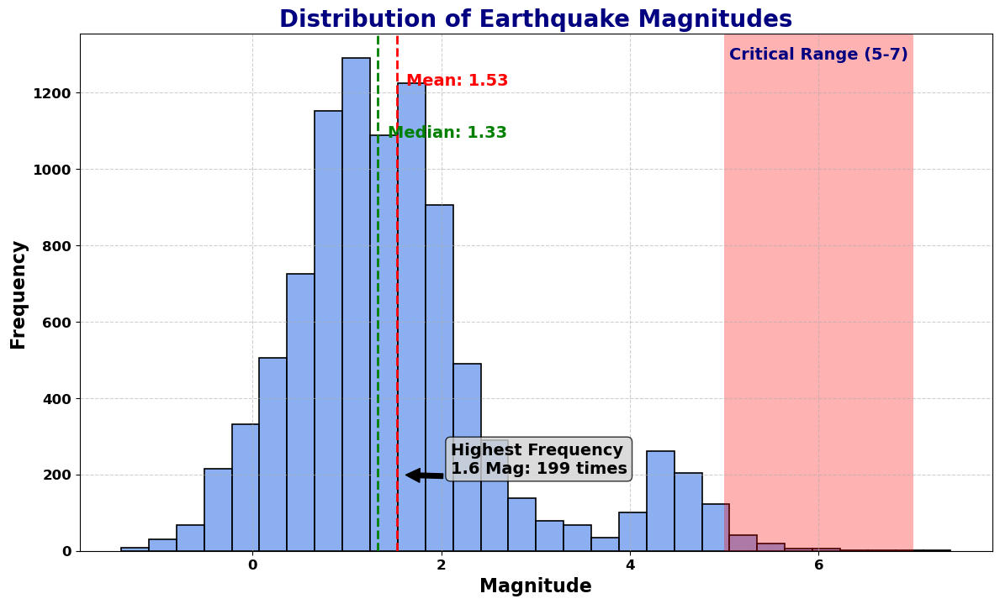

In [16]:
# Plot the enhanced magnitude distribution with blue hues
plot_magnitude_distribution(processed_data)

In [17]:
# Display the enhanced map
enhanced_earthquake_map = plot_enhanced_geo_map(processed_data)
enhanced_earthquake_map.save("enhanced_earthquake_map.html")
enhanced_earthquake_map

In [18]:
features = ["Latitude", "Longitude", "Depth", "Year", "Month", "Day", "Hour", "Minute", "Second"]

processed_data["Target"] = (processed_data["Magnitude"] >= 5.0).astype(int)

X = processed_data[features]
y = processed_data["Target"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(X_train.shape, X_test.shape)
# (7360, 9) (1840, 9)

print("Large earthquake train (%): ", round(y_train[y_train == 1].shape[0] / y_train.shape[0] * 100, 2))
print("Non large earthquake test (%): ", round(y_test[y_test == 1].shape[0] / y_test.shape[0] * 100, 2))
# Large earthquake train (%):  1.14
# Non large earthquake test (%):  1.41

X_train = X_train.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)
y_train = y_train.reset_index(drop=True)
y_test = y_test.reset_index(drop=True)

X_train_orig = X_train.copy()


(7531, 9) (1883, 9)
Large earthquake train (%):  1.09
Non large earthquake test (%):  1.54


In [19]:
TARGET = "Target"

### Examine the features

In [20]:
y = y_train.copy()
X = X_train.copy()

for colname in X.select_dtypes("object"):
    X[colname], _ = X[colname].factorize()

discrete_features = X.dtypes == int

In [21]:
mi_scores = make_mi_scores(X, y, discrete_features)
mi_scores

Longitude    2.374789e-02
Latitude     2.171788e-02
Depth        1.975296e-02
Minute       4.540765e-03
Second       4.038261e-03
Day          2.538088e-03
Hour         1.437030e-03
Month        6.696389e-05
Year         1.757275e-15
Name: MI Scores, dtype: float64

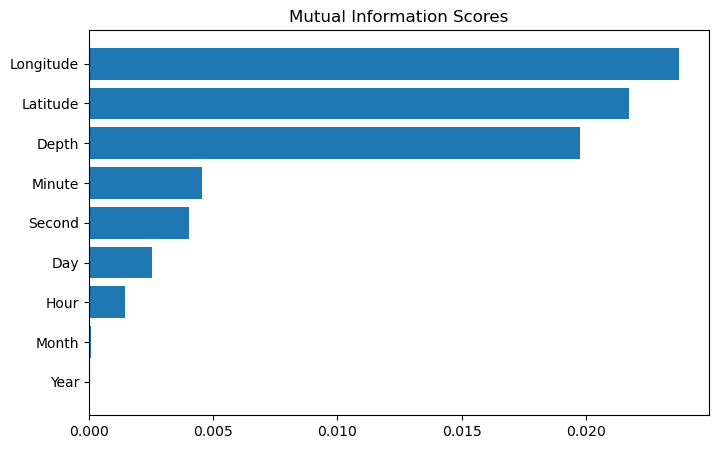

In [22]:
plt.figure(dpi=100, figsize=(8, 5))
plot_mi_scores(mi_scores)
plt.show()

In [23]:
sel_five_cols = SelectKBest(mutual_info_classif, k=5)
sel_five_cols.fit(X, y)
X_train.columns[sel_five_cols.get_support()]

Index(['Latitude', 'Longitude', 'Depth', 'Year', 'Month'], dtype='object')

### Transform the model data

In [24]:
# Multicollinearity

num_cols = X_train.select_dtypes(include=np.number).columns.tolist()

vif = calculate_vif(X_train[num_cols])

high_vif = vif[(vif.VIF > 10)]
to_drop_vif = list(high_vif.Features)
print(to_drop_vif)
vif.sort_values(["VIF"], ascending = False)

['Year']


,Features,VIF
3,Year,667.019737
5,Day,2.420457
4,Month,2.412744
0,Latitude,1.154795
1,Longitude,1.131661
2,Depth,1.082607
6,Hour,1.004224
7,Minute,1.000900
8,Second,1.000634


In [25]:
try:
    X_train = X_train.drop(to_drop_vif, axis = 1)
    X_test = X_test.drop(to_drop_vif, axis = 1)
except KeyError:
    X_train = X_train
    X_test = X_test

#### Correlation

[]


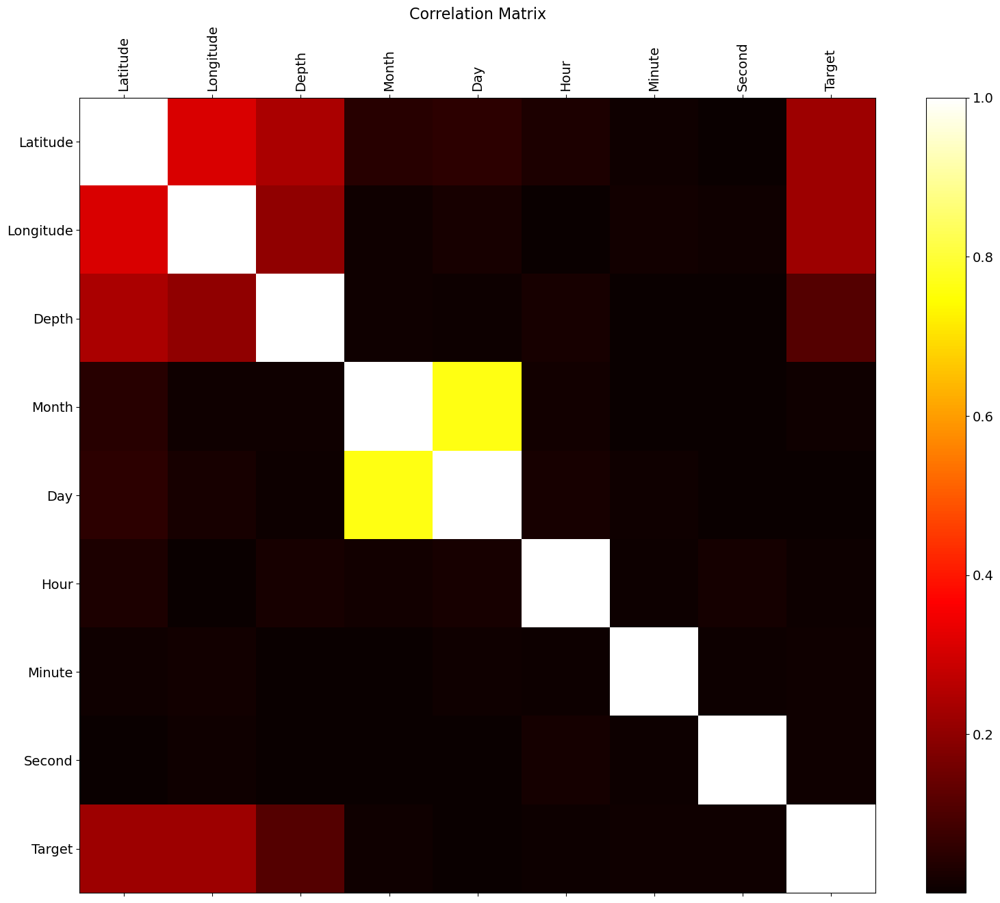

In [26]:
num_cols = X_train.select_dtypes(include=np.number).columns.tolist()
corre_data = pd.concat([X_train[num_cols], pd.DataFrame(y_train)], axis=1)

cor_matrix = corre_data.corr().abs()
upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape), k=1).astype(bool))

to_drop_corr = [column for column in upper_tri.columns if any(upper_tri[column] > 0.8)]
print(to_drop_corr)

f = plt.figure(figsize=(19, 15))
plt.matshow(cor_matrix, fignum=f.number, cmap=plt.get_cmap("hot"))
plt.xticks(
    range(corre_data.select_dtypes(["number"]).shape[1]),
    corre_data.select_dtypes(["number"]).columns,
    fontsize=14,
    rotation=90,
)
plt.yticks(
    range(corre_data.select_dtypes(["number"]).shape[1]), corre_data.select_dtypes(["number"]).columns, fontsize=14
)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title("Correlation Matrix", fontsize=16)
plt.show()


In [27]:
try:
    X_train = X_train.drop(to_drop_corr, axis = 1)
    X_test = X_test.drop(to_drop_corr, axis = 1)
except KeyError:
    X_train = X_train
    X_test = X_test

In [28]:
# High cardinality adjustment

cat_cols = X_train.select_dtypes(include=["object", "category"]).columns.tolist()

card_vars = []
cat_data = X_train[cat_cols]
for i in range(cat_data.shape[1]):
    X_train.loc[X_train[cat_data.columns[i]].isnull(), cat_data.columns[i]] = "Missing"
    X_test.loc[X_test[cat_data.columns[i]].isnull(), cat_data.columns[i]] = "Missing"

    if len(list(set(cat_data.iloc[:, i]))) > 100:
        card_vars.append(cat_data.columns[i])

    if cat_data.iloc[:, i].nunique() > 60:
        print(cat_data.columns[i], len(list(set(cat_data.iloc[:, i]))))

        a = pd.crosstab(cat_data[cat_data.columns[i]], columns="Count")
        a = pd.DataFrame(a).sort_values("Count", ascending=False).reset_index()
        val_list = list(a.iloc[:30, 0])
        X_train.loc[~X_train[cat_data.columns[i]].isin(val_list), cat_data.columns[i]] = "Other"
        X_test.loc[~X_test[cat_data.columns[i]].isin(val_list), cat_data.columns[i]] = "Other"

print(card_vars)


[]


#### Preprocess the data

In [29]:
num_cols = list(X_train.select_dtypes(include=["number"], exclude=["datetime", "timedelta"]).columns)
num_cols = (list(set(num_cols) - set([col for col in X_train.columns if ("_n" in col) or ("feature_" in col)])))
print(num_cols)

cat_cols = list(X_train.select_dtypes(include=["object", "category"]))
cat_cols = (list(set(cat_cols) - set([col for col in X_train.columns if "_bin" in col])))
print(cat_cols)

['Depth', 'Hour', 'Day', 'Month', 'Latitude', 'Second', 'Minute', 'Longitude']
[]


In [30]:
preprocessor = ColumnTransformer(
        transformers=[
            ("num", StandardScaler(), num_cols),
            ("cat", OneHotEncoder(), cat_cols)
        ],
        remainder="passthrough"
)

X_train_proc = pd.DataFrame(preprocessor.fit_transform(X_train), columns=preprocessor.get_feature_names_out())
X_test_proc = pd.DataFrame(preprocessor.fit_transform(X_test), columns=preprocessor.get_feature_names_out())

print(X_train_proc.shape, X_test_proc.shape)

print(
    f"Data min:max {X_train_proc[[col for col in X_train_proc.columns if ('cat__' in col) or ('num__' in col)]].min().min(), X_train_proc[[col for col in X_train_proc.columns if ('cat__' in col) or ('num__' in col)]].max().max()}"
)
print(
    f"Data min:max {X_test_proc[[col for col in X_test_proc.columns if ('cat_' in col) or ('num__' in col)]].min().min(), X_test_proc[[col for col in X_test_proc.columns if ('cat_' in col) or ('num__' in col)]].max().max()}"
)

print(X_train_proc.columns)

(7531, 8) (1883, 8)
Data min:max (-5.546174080102538, 11.194907814879825)
Data min:max (-5.103158613731396, 11.837503351713561)
Index(['num__Depth', 'num__Hour', 'num__Day', 'num__Month', 'num__Latitude',
       'num__Second', 'num__Minute', 'num__Longitude'],
      dtype='object')


In [31]:
# Check that train/test sets have same columns

mod_cols = (list(set(list(X_train_proc.columns)) - set(["index"])))
X_train_mod = X_train_proc[mod_cols]
miss_lst = list(set(list(X_train_mod.columns)) - set(list(X_test_proc.columns)))

for name in miss_lst:
    X_test_proc[name] = 0
X_test_mod = X_test_proc[list(X_train_mod.columns)]

drop_test_lst = list(set(list(X_test_mod.columns)) - set(list(X_train_mod.columns)))
X_test_mod = X_test_mod.drop(drop_test_lst, axis = 1)

print(X_train_mod.shape, X_test_mod.shape)
# (7360, 7) (1840, 7)

(7531, 8) (1883, 8)


### Store data

In [32]:
X_train_mod.to_feather(os.path.join(path_folder, "data/X_train_mod.ftr"))
X_test_mod.to_feather(os.path.join(path_folder, "data/X_test_mod.ftr"))
y_train_df = pd.DataFrame(y_train)
y_train_df.to_feather(os.path.join(path_folder, "data/y_train.ftr"))
y_test_df = pd.DataFrame(y_test)
y_test_df.to_feather(os.path.join(path_folder, "data/y_test.ftr"))

print(X_train_mod.shape, X_test_mod.shape, y_train_df.shape, y_test_df.shape)
# (7360, 7) (1840, 7) (7360, 1) (1840, 1)

(7531, 8) (1883, 8) (7531, 1) (1883, 1)


### Baseline models

In [33]:
X_train_mod = pd.read_feather(os.path.join(path_folder, "data/X_train_mod.ftr"), columns=None, use_threads=True)
X_test_mod = pd.read_feather(os.path.join(path_folder, "data/X_test_mod.ftr"), columns=None, use_threads=True)
y_train = pd.read_feather(os.path.join(path_folder, "data/y_train.ftr"), columns=None, use_threads=True)
y_test = pd.read_feather(os.path.join(path_folder, "data/y_test.ftr"), columns=None, use_threads=True)

y_train = y_train[TARGET]
y_test = y_test[TARGET]

print(y_train.unique(), y_test.unique())

print(X_train_mod.shape, X_test_mod.shape, y_train.shape, y_test.shape)
# (7360, 7) (1840, 7) (7360,) (1840,)

[0 1] [0 1]
(7531, 8) (1883, 8) (7531,) (1883,)


In [34]:
#X_train_mod.columns = X_train_mod.columns.str.removeprefix("cat__")
X_train_mod.columns = X_train_mod.columns.str.removeprefix("num__")
#X_train_mod.columns = X_train_mod.columns.str.removeprefix("remainder__")

#X_test_mod.columns = X_test_mod.columns.str.removeprefix("cat__")
X_test_mod.columns = X_test_mod.columns.str.removeprefix("num__")
#X_test_mod.columns = X_test_mod.columns.str.removeprefix("remainder__")

### Baseline model

In [35]:
mlflow.set_tracking_uri("http://127.0.0.1:5000")
tracking_uri = mlflow.get_tracking_uri()

mlflc = MLflowCallback(
    tracking_uri = tracking_uri,
    metric_name = "auc",
)

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/3952707444.py:4: ExperimentalWarning: MLflowCallback is experimental (supported from v1.4.0). The interface can change in the future.
  mlflc = MLflowCallback(


In [36]:
mlflow.end_run()

accuracy_lst_lr = []
precision_lst_lr = []
recall_lst_lr = []
f1_lst_lr = []
auc_lst_lr = []

log_reg_params = {"penalty": ["none"]}

grid_log_reg = GridSearchCV(LogisticRegression(), log_reg_params, cv=3, verbose=2, n_jobs=-1)

date_run = datetime.now().strftime("%Y%m%d_%H%M%S")
mlflow.set_experiment(f"LogisticRegression_experiment_{date_run}")

with mlflow.start_run():
    mlflow.set_tag("optimizer", "GridSearchCV")
    mlflow.set_tag("algorithm", "LogisticRegression")
    print("artifact uri:", mlflow.get_artifact_uri())

    lr_run_id = mlflow.active_run().info.run_id
    print("Run id:", lr_run_id)

    sss = StratifiedKFold(n_splits=5, random_state=42, shuffle=True)

    for train, val in sss.split(X_train_mod, y_train):
        with mlflow.start_run(nested=True):
            pipeline_lr = imbalanced_make_pipeline(SMOTE(sampling_strategy="minority"), grid_log_reg)
            model_lr = pipeline_lr.fit(X_train_mod.iloc[train], y_train.iloc[train])
            best_est_lr = grid_log_reg.best_estimator_

            mlflow.log_params(grid_log_reg.best_params_)

            metric_vals(accuracy_lst_lr, precision_lst_lr, recall_lst_lr, f1_lst_lr, auc_lst_lr, best_est_lr, X_train_mod.iloc[val], y_train.iloc[val])

            mlflow.log_metric("Accuracy", accuracy_lst_lr[0])
            mlflow.log_metric("Precision", precision_lst_lr[0])
            mlflow.log_metric("Recall", recall_lst_lr[0])
            mlflow.log_metric("F1", f1_lst_lr[0])
            mlflow.log_metric("AUC", auc_lst_lr[0])

print("---" * 45)
print("")
print("accuracy: {}".format(np.mean(accuracy_lst_lr)))
print("precision: {}".format(np.mean(precision_lst_lr)))
print("recall: {}".format(np.mean(recall_lst_lr)))
print("f1: {}".format(np.mean(f1_lst_lr)))
print("auc: {}".format(np.mean(auc_lst_lr)))
print("---" * 45)

mlflow.sklearn.log_model(grid_log_reg.best_estimator_, "LR_model")

mlflow.end_run()

2024/07/23 15:03:31 INFO mlflow.tracking.fluent: Experiment with name 'LogisticRegression_experiment_20240723_150330' does not exist. Creating a new experiment.


artifact uri: mlflow-artifacts:/386851538405677244/cc3ac8c1744d4690b2d4b9faeb4d3638/artifacts
Run id: cc3ac8c1744d4690b2d4b9faeb4d3638
Fitting 3 folds for each of 1 candidates, totalling 3 fits
[CV] END .......................................penalty=none; total time=   0.0s
[CV] END .......................................penalty=none; total time=   0.0s[CV] END .......................................penalty=none; total time=   0.0s

[[1390  100]
 [   2   15]]
Fitting 3 folds for each of 1 candidates, totalling 3 fits
[CV] END .......................................penalty=none; total time=   0.0s
[CV] END .......................................penalty=none; total time=   0.0s
[CV] END .......................................penalty=none; total time=   0.0s
[[1375  115]
 [   1   15]]
Fitting 3 folds for each of 1 candidates, totalling 3 fits
[CV] END .......................................penalty=none; total time=   0.0s
[CV] END .......................................penalty=none; total

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/_distutils_hack/__init__.py:33: UserWarning: Setuptools is replacing distutils.
  warnings.warn("Setuptools is replacing distutils.")


In [37]:
train_res_df = train_res_proc([auc_lst_lr, accuracy_lst_lr, precision_lst_lr, recall_lst_lr, f1_lst_lr], "Logistic Regression")
train_res_df

,0,1,2,3,4,Metric,Model
0,0.907619,0.930159,0.836745,0.935529,0.903567,AUC,Logistic Regression
1,0.932316,0.922975,0.921647,0.933599,0.924303,Accuracy,Logistic Regression
2,0.130435,0.115385,0.095238,0.131579,0.118110,Precision,Logistic Regression
3,0.882353,0.937500,0.750000,0.937500,0.882353,Recall,Logistic Regression
4,0.227273,0.205479,0.169014,0.230769,0.208333,F1 score,Logistic Regression


### Model requirements

In [38]:
n_splits = 3

cv = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=31416)

### Optuna - XGBoost

In [39]:
@mlflc.track_in_mlflow()

def xgb_opt_objective(trial):

    params = {
        "objective": "binary:logistic",
        "eval_metric": "auc",
        "max_depth": trial.suggest_int("max_depth", 4, 15, 1),
        "subsample": trial.suggest_float("subsample", 0.5, 1.0),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.1),
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 10),
        "alpha": trial.suggest_float("alpha", 1e-8, 1.0),
        "lambda": trial.suggest_float("lambda", 1e-8, 1.0),
        "gamma": trial.suggest_float("gamma", 1e-8, 1.0),
        "verbosity": 0,
        "random_state": 42,
    }

    kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=0)

    model = xgb.XGBClassifier(**params)

    steps = [("over", SMOTE()), ("model", model)]
    pipeline = imbpipeline(steps=steps)

    score = cross_val_score(pipeline, X=X_train_mod, y=y_train, cv=kfold, scoring="roc_auc", n_jobs=-1).mean()

    return score


date_run = datetime.now().strftime("%Y%m%d_%H%M%S")

xgb_study = optuna.create_study(direction="maximize", study_name=f"xgb_opt_{date_run}")

xgb_study.optimize(xgb_opt_objective, n_trials=10, callbacks=[mlflc])

# Get the best hyperparameters and corresponding score

best_params_xgb = xgb_study.best_params
best_score_xgb = xgb_study.best_value

print(f"Best Hyperparameters: {best_params_xgb}")
# Best Hyperparameters: {'max_depth': 7, 'subsample': 0.5556236159396959, 'learning_rate': 0.051255839276416436, 'min_child_weight': 4, 'alpha': 0.8542465941649752, 'lambda': 0.29205487140921726, 'gamma': 0.1399279847637883}

print(f"Best Validation Accuracy: {best_score_xgb}")

# Best Validation Accuracy: 0.84306453063567


/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/470613665.py:1: ExperimentalWarning: track_in_mlflow is experimental (supported from v2.9.0). The interface can change in the future.
  @mlflc.track_in_mlflow()
[I 2024-07-23 15:03:50,669] A new study created in memory with name: xgb_opt_20240723_150350
2024/07/23 15:03:51 INFO mlflow.tracking.fluent: Experiment with name 'xgb_opt_20240723_150350' does not exist. Creating a new experiment.
[I 2024-07-23 15:03:53,533] Trial 0 finished with value: 0.9328392504657774 and parameters: {'max_depth': 5, 'subsample': 0.9138214507352935, 'learning_rate': 0.060798146598193846, 'min_child_weight': 4, 'alpha': 0.10883549992546614, 'lambda': 0.5401737410779721, 'gamma': 0.4703153342148419}. Best is trial 0 with value: 0.9328392504657774.
[I 2024-07-23 15:03:56,124] Trial 1 finished with value: 0.9612896798760673 and parameters: {'max_depth': 13, 'subsample': 0.505910258269532, 'learning_rate': 0.011287686578096185, 'min_child_weight':

Best Hyperparameters: {'max_depth': 13, 'subsample': 0.505910258269532, 'learning_rate': 0.011287686578096185, 'min_child_weight': 3, 'alpha': 0.7438040157619862, 'lambda': 0.9403599092155546, 'gamma': 0.5167711259686412}
Best Validation Accuracy: 0.9612896798760673


In [40]:
xgb_model = xgb.XGBClassifier(**best_params_xgb)
xgb_model.fit(X_train_mod, y_train, verbose=2)
mlflow.sklearn.log_model(xgb_model, "XGB_model")

print("artifact uri:", mlflow.get_artifact_uri())
xgb_run_id = mlflow.active_run().info.run_id
print("Run id:", xgb_run_id)
mlflow.end_run()

artifact uri: mlflow-artifacts:/568655852846705119/c7561e7d7fab4fb5827edc612747b8d7/artifacts
Run id: c7561e7d7fab4fb5827edc612747b8d7


In [41]:
filepath_xgb = os.path.join(path_folder, "models/xgb_opt_from_pickle.pkl")
pickle.dump(xgb_model, open(filepath_xgb, 'wb'))

2024/07/23 15:04:24 INFO mlflow.tracking.fluent: Experiment with name 'XGB_opt_optimized_20240723_150424' does not exist. Creating a new experiment.
0it [00:00, ?it/s]

ROC/AUC: 0.8946
Accuracy: 0.9506
F1 score: 0.253
MCC score: 0.3239
              precision    recall  f1-score   support

           0       1.00      0.95      0.97      2483
           1       0.15      0.75      0.25        28

    accuracy                           0.95      2511
   macro avg       0.57      0.85      0.61      2511
weighted avg       0.99      0.95      0.97      2511



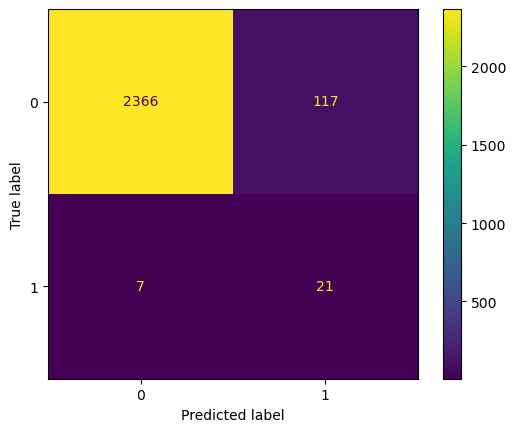

Best Threshold=0.320940, G-Mean=0.896


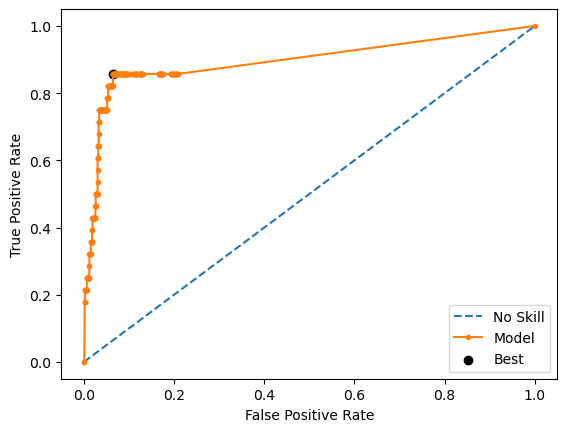

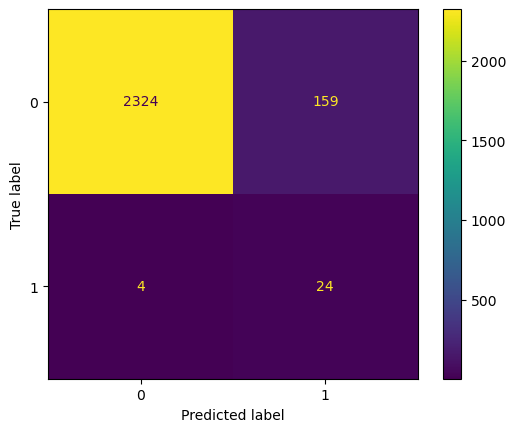

Accuracy threshold: 0.9351
F1 score threshold: 0.2275
MCC score: 0.3204
              precision    recall  f1-score   support

           0       1.00      0.94      0.97      2483
           1       0.13      0.86      0.23        28

    accuracy                           0.94      2511
   macro avg       0.56      0.90      0.60      2511
weighted avg       0.99      0.94      0.96      2511

Optimal threshold: 0.5


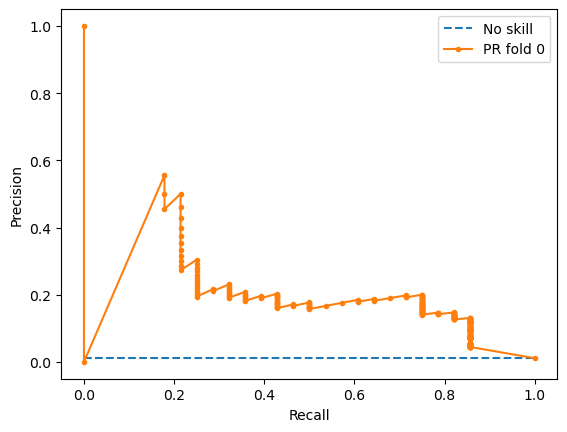

1it [00:02,  2.28s/it]

ROC/AUC: 0.9648
Accuracy: 0.9442
F1 score: 0.2222
MCC score: 0.2963
              precision    recall  f1-score   support

           0       1.00      0.95      0.97      2483
           1       0.13      0.74      0.22        27

    accuracy                           0.94      2510
   macro avg       0.56      0.84      0.60      2510
weighted avg       0.99      0.94      0.96      2510



<Figure size 640x480 with 0 Axes>

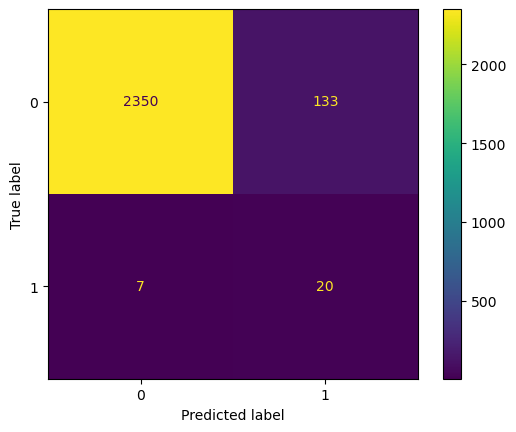

Best Threshold=0.253095, G-Mean=0.943


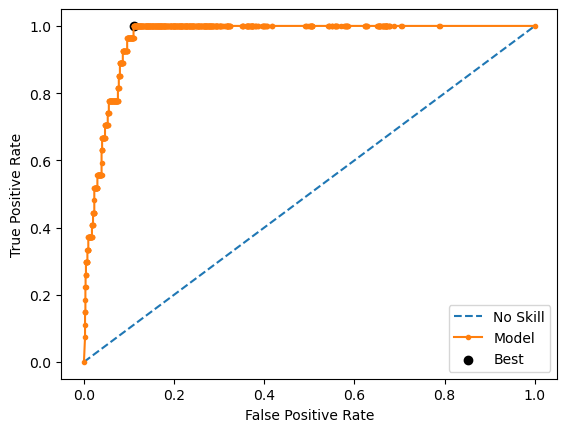

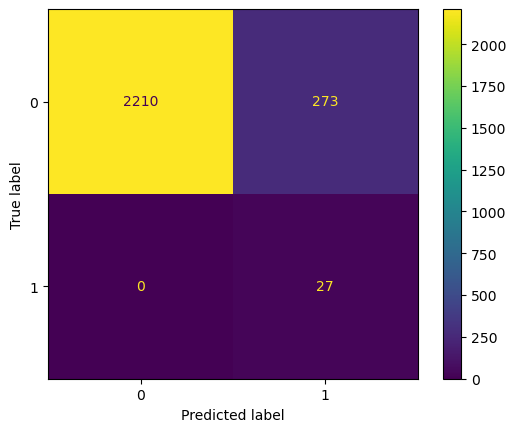

Accuracy threshold: 0.8912
F1 score threshold: 0.1651
MCC score: 0.283
              precision    recall  f1-score   support

           0       1.00      0.89      0.94      2483
           1       0.09      1.00      0.17        27

    accuracy                           0.89      2510
   macro avg       0.55      0.95      0.55      2510
weighted avg       0.99      0.89      0.93      2510

Optimal threshold: 0.5


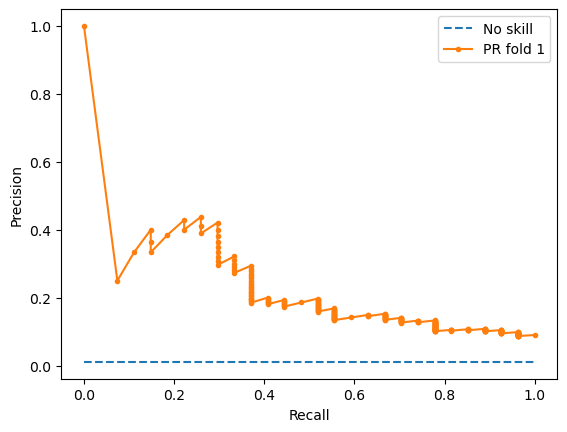

2it [00:04,  2.30s/it]

ROC/AUC: 0.9201
Accuracy: 0.9558
F1 score: 0.2238
MCC score: 0.2714
              precision    recall  f1-score   support

           0       1.00      0.96      0.98      2483
           1       0.14      0.59      0.22        27

    accuracy                           0.96      2510
   macro avg       0.57      0.78      0.60      2510
weighted avg       0.99      0.96      0.97      2510



<Figure size 640x480 with 0 Axes>

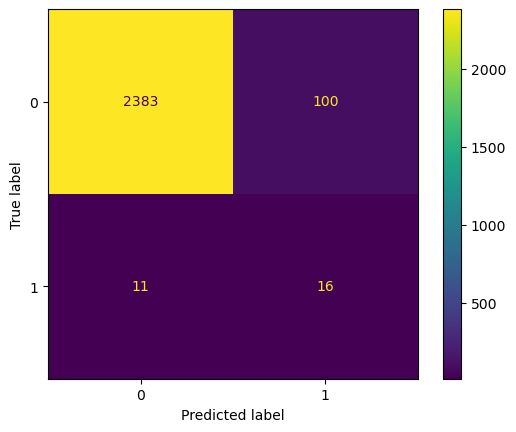

Best Threshold=0.233520, G-Mean=0.916


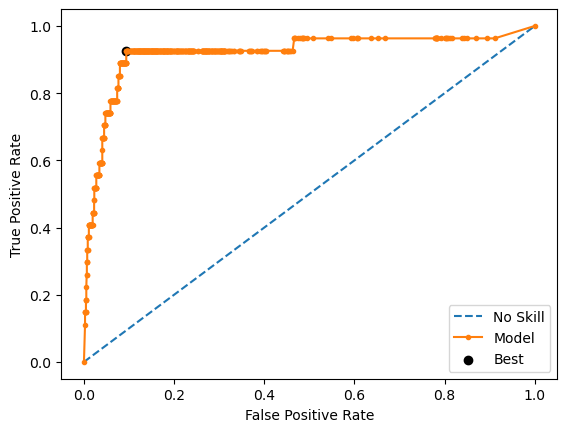

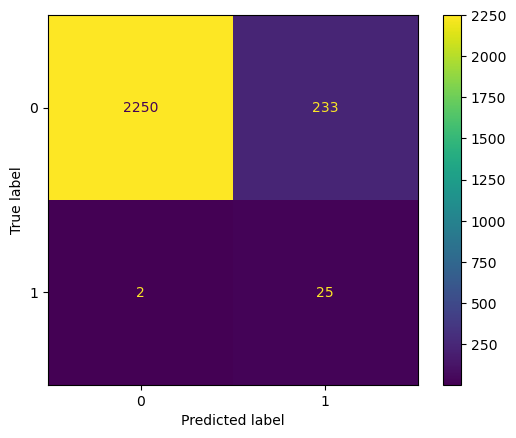

Accuracy threshold: 0.9064
F1 score threshold: 0.1754
MCC score: 0.2826
              precision    recall  f1-score   support

           0       1.00      0.91      0.95      2483
           1       0.10      0.93      0.18        27

    accuracy                           0.91      2510
   macro avg       0.55      0.92      0.56      2510
weighted avg       0.99      0.91      0.94      2510

Optimal threshold: 0.5


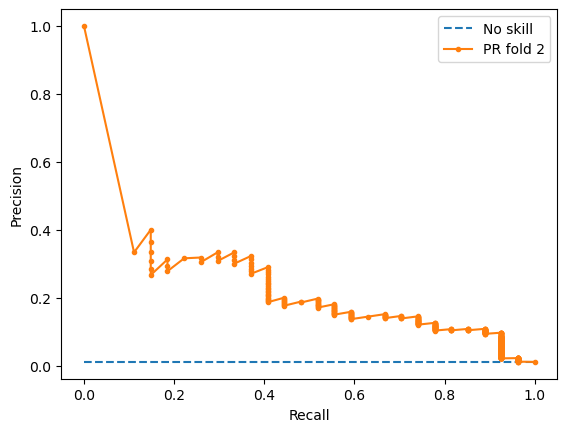

3it [00:06,  2.21s/it]


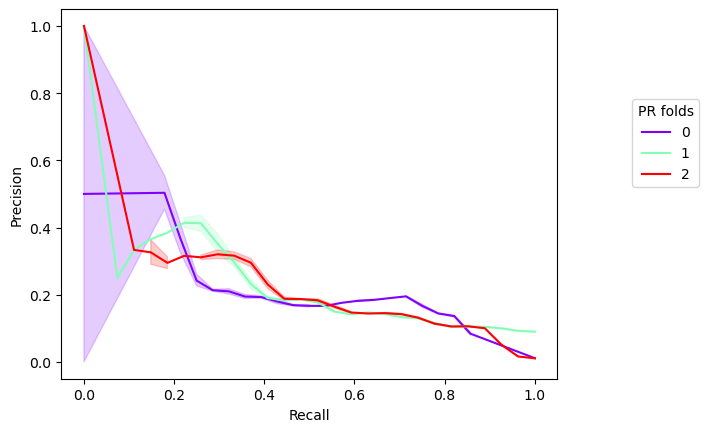

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.
  warnings.warn(msg, category=FutureWarning)
/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarn

<Figure size 640x480 with 0 Axes>

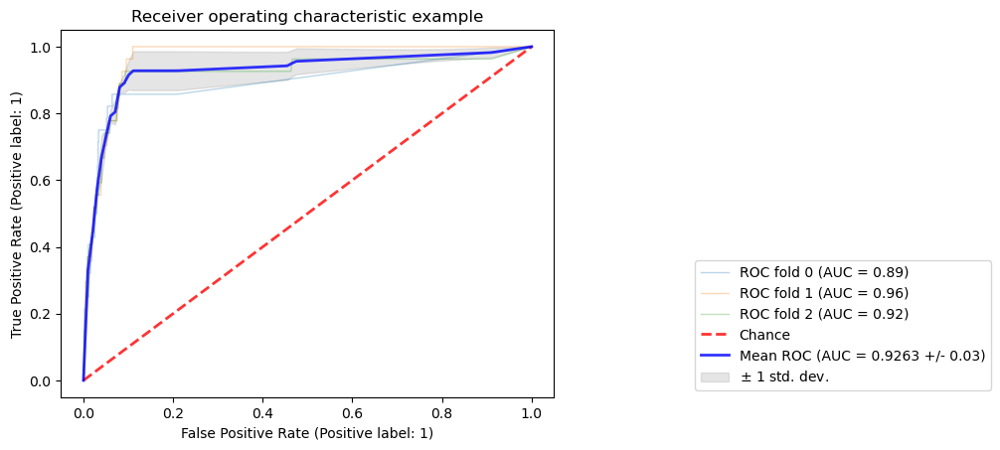

In [42]:
try:
    logged_model = f"runs:/{xgb_run_id}/XGB_model"
    xgb_opt_from_pickle = mlflow.sklearn.load_model(logged_model)

except Exception:
    filepath_xgb = os.path.join(path_folder, "models/xgb_opt_from_pickle.pkl")
    with open(filepath_xgb, 'rb') as fp_lgbm:
        xgb_opt_from_pickle = pickle.load(fp_lgbm)
    xgb_opt_from_pickle.fit(X_train_mod, y_train)

xgb_opt_res, xgb_opt_threshold, xgb_pr_data_train, xgb_roc_data_train  = train_diag_mlflow(
        xgb_opt_from_pickle, X_train_mod, y_train, n_splits, "XGB_opt_optimized"
)

In [43]:
plot_optimization_history(xgb_study)

In [44]:
plot_param_importances(xgb_study)

### LGBM - Optuna

In [45]:
%time

@mlflc.track_in_mlflow()

def lgbm_opt_objective(trial):

    params = {
        "application": "binary",
        "metric": "auc",
        "max_depth": trial.suggest_int("max_depth", 4, 15, 1),
        "num_leaves": trial.suggest_int("num_leaves", 20, 80, 10),
        "learning_rate": trial.suggest_float("learning_rate", 0.01, 0.1),
        "feature_fraction": trial.suggest_float("feature_fraction", 1e-8, 1.0),
        "bagging_fraction": trial.suggest_float("bagging_fraction", 1e-8, 1.0),
        "max_bin" : trial.suggest_int("max_bin", 20, 90, 10),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 20, 80, 10),
        "min_sum_hessian_in_leaf" : trial.suggest_int("min_sum_hessian_in_leaf", 20, 90, 10),
        "random_state": 42
    }

    train_data = lgb.Dataset(data = X_train_mod,
                             label = y_train,
                             free_raw_data = False)

    model = lgb.cv(params,
                   train_data,
                   nfold = 10,
                   seed = 6,
                   stratified = True,
                   verbose_eval = 2,
                   metrics = ["auc"])
    score = np.mean(model["auc-mean"])

    mlflow.sklearn.log_model(model, "model")

    return score

date_run = datetime.now().strftime("%Y%m%d_%H%M%S")
lgbm_study = optuna.create_study(direction="maximize",
                                 study_name=f"lgbm_opt_{date_run}")

lgbm_study.optimize(lgbm_opt_objective, n_trials = 50, callbacks = [mlflc])

# Get the best hyperparameters and corresponding score
best_params_lgbm = lgbm_study.best_params
best_score_lgbm = lgbm_study.best_value

print(f"Best Hyperparameters: {best_params_lgbm}")

# Best Hyperparameters: {'max_depth': 6, 'num_leaves': 20, 'learning_rate': 0.0728471773200164, 'feature_fraction': 0.37430614334371154, 'bagging_fraction': 0.18068756836405517, 'max_bin': 30, 'min_data_in_leaf': 40, 'min_sum_hessian_in_leaf': 30}

print(f"Best Validation Accuracy: {best_score_lgbm}")
# Best Validation Accuracy: 0.8531173244470115

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/559351835.py:3: ExperimentalWarning:

track_in_mlflow is experimental (supported from v2.9.0). The interface can change in the future.

[I 2024-07-23 15:04:39,601] A new study created in memory with name: lgbm_opt_20240723_150439


CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 7.15 µs


2024/07/23 15:04:40 INFO mlflow.tracking.fluent: Experiment with name 'lgbm_opt_20240723_150439' does not exist. Creating a new experiment.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000515 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000271 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000485 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:04:40 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:04:44,099] Trial 0 finished with value: 0.5 and parameters: {'max_depth': 12, 'num_leaves': 60, 'learning_rate': 0.017894764108376558, 'feature_fraction': 0.3494038666893852, 'bagging_fraction': 0.06622721773988925, 'max_bin': 60, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 40}. Best is trial 0 with value: 0.5.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001292 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003839 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002774 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.010918 -> initscore=-4.506395
[LightGBM] [Info] Start training from score -4.506395
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.010918 -> initscore=-4.506395
[LightGBM] [Info] Start training from score -4.506395
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.010918 -> initscore=-4.506395
[LightGBM] [Info] Start training from score -4.506395
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.010918 -> i

2024/07/23 15:04:46 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:04:50,021] Trial 1 finished with value: 0.5 and parameters: {'max_depth': 9, 'num_leaves': 40, 'learning_rate': 0.02412184880864047, 'feature_fraction': 0.2241846193407326, 'bagging_fraction': 0.5000673332668445, 'max_bin': 90, 'min_data_in_leaf': 80, 'min_sum_hessian_in_leaf': 90}. Best is trial 0 with value: 0.5.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000732 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000343 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[34]	cv_agg's auc: 0.923314 + 0.0287435
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:04:51 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[80]	cv_agg's auc: 0.930846 + 0.0231282
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:04:54,807] Trial 2 finished with value: 0.9175290151187125 and parameters: {'max_depth': 14, 'num_leaves': 30, 'learning_rate': 0.09098094206509415, 'feature_fraction': 0.8589722729960447, 'bagging_fraction': 0.1216952979024625, 'max_bin': 70, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 30}. Best is trial 2 with value: 0.9175290151187125.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001062 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000938 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000534 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[20]	cv_agg's auc: 0.5 + 0
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

2024/07/23 15:04:56 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:04:59,388] Trial 3 finished with value: 0.5 and parameters: {'max_depth': 6, 'num_leaves': 40, 'learning_rate': 0.045703207003283036, 'feature_fraction': 0.6086444627941099, 'bagging_fraction': 0.9396875650375217, 'max_bin': 90, 'min_data_in_leaf': 30, 'min_sum_hessian_in_leaf': 70}. Best is trial 2 with value: 0.9175290151187125.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000497 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000349 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[42]	cv_agg's auc: 0.5 + 0
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

2024/07/23 15:05:00 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:05:04,030] Trial 4 finished with value: 0.5 and parameters: {'max_depth': 11, 'num_leaves': 30, 'learning_rate': 0.01587617620048248, 'feature_fraction': 0.6722971852532336, 'bagging_fraction': 0.70744298612361, 'max_bin': 50, 'min_data_in_leaf': 30, 'min_sum_hessian_in_leaf': 90}. Best is trial 2 with value: 0.9175290151187125.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000598 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000349 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[20]	cv_agg's auc: 0.5 + 0
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

2024/07/23 15:05:05 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!
[I 2024-07-23 15:05:08,595] Trial 5 finished with value: 0.5 and parameters: {'max_depth': 7, 'num_leaves': 80, 'learning_rate': 0.0671429545668178, 'feature_fraction': 0.9562973757588542, 'bagging_fraction': 0.4321854233123161, 'max_bin': 50, 'min_data_in_leaf': 40, 'min_sum_hessian_in_leaf': 90}. Best is trial 2 with value: 0.9175290151187125.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000454 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000490 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000416 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 451
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[

2024/07/23 15:05:10 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:05:13,507] Trial 6 finished with value: 0.5 and parameters: {'max_depth': 13, 'num_leaves': 30, 'learning_rate': 0.09191622269519628, 'feature_fraction': 0.8364239799449052, 'bagging_fraction': 0.9271769639689705, 'max_bin': 90, 'min_data_in_leaf': 20, 'min_sum_hessian_in_leaf': 60}. Best is trial 2 with value: 0.9175290151187125.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000551 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000449 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000746 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:05:14 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:05:18,036] Trial 7 finished with value: 0.5 and parameters: {'max_depth': 15, 'num_leaves': 70, 'learning_rate': 0.04305337342843832, 'feature_fraction': 0.6099560071754784, 'bagging_fraction': 0.5979247848206451, 'max_bin': 30, 'min_data_in_leaf': 40, 'min_sum_hessian_in_leaf': 50}. Best is trial 2 with value: 0.9175290151187125.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000798 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 421
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000612 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 421
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001476 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 421
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:05:19 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:05:22,802] Trial 8 finished with value: 0.5 and parameters: {'max_depth': 8, 'num_leaves': 50, 'learning_rate': 0.037266318782615944, 'feature_fraction': 0.8587395926273272, 'bagging_fraction': 0.9788498352566715, 'max_bin': 80, 'min_data_in_leaf': 40, 'min_sum_hessian_in_leaf': 70}. Best is trial 2 with value: 0.9175290151187125.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000563 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000657 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000447 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[22]	cv_agg's auc: 0.5 + 0
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

2024/07/23 15:05:24 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:05:28,190] Trial 9 finished with value: 0.5 and parameters: {'max_depth': 6, 'num_leaves': 50, 'learning_rate': 0.029795868187923603, 'feature_fraction': 0.3162989916608347, 'bagging_fraction': 0.06117300608702556, 'max_bin': 60, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 60}. Best is trial 2 with value: 0.9175290151187125.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000468 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000625 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[16]	cv_agg's auc: 0.934055 + 0.0215619
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:05:30 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[100]	cv_agg's auc: 0.951283 + 0.0183116


[I 2024-07-23 15:05:33,363] Trial 10 finished with value: 0.9395239218245091 and parameters: {'max_depth': 15, 'num_leaves': 20, 'learning_rate': 0.09893921323598648, 'feature_fraction': 0.9998611935960514, 'bagging_fraction': 0.24339177079671498, 'max_bin': 20, 'min_data_in_leaf': 70, 'min_sum_hessian_in_leaf': 20}. Best is trial 10 with value: 0.9395239218245091.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000308 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000452 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[18]	cv_agg's auc: 0.935052 + 0.0228669
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:05:35 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[80]	cv_agg's auc: 0.950264 + 0.0183639
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:05:38,494] Trial 11 finished with value: 0.9396482468748246 and parameters: {'max_depth': 15, 'num_leaves': 20, 'learning_rate': 0.09771882801614877, 'feature_fraction': 0.9766149394295642, 'bagging_fraction': 0.21975359601933014, 'max_bin': 20, 'min_data_in_leaf': 70, 'min_sum_hessian_in_leaf': 20}. Best is trial 11 with value: 0.9396482468748246.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000511 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000573 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[18]	cv_agg's auc: 0.93646 + 0.0221083
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

2024/07/23 15:05:40 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[96]	cv_agg's auc: 0.951361 + 0.01802
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

[I 2024-07-23 15:05:44,236] Trial 12 finished with value: 0.9403794430011305 and parameters: {'max_depth': 4, 'num_leaves': 20, 'learning_rate': 0.0994593084947736, 'feature_fraction': 0.9947332939827555, 'bagging_fraction': 0.2559138587280927, 'max_bin': 20, 'min_data_in_leaf': 80, 'min_sum_hessian_in_leaf': 20}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000328 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000700 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000740 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[30]	cv_agg's auc: 0.941991 + 0.0205772
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:05:46 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[58]	cv_agg's auc: 0.949121 + 0.0185076
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:05:49,347] Trial 13 finished with value: 0.9385115087240304 and parameters: {'max_depth': 4, 'num_leaves': 20, 'learning_rate': 0.07775576837068396, 'feature_fraction': 0.7634665831891395, 'bagging_fraction': 0.27562603297344573, 'max_bin': 30, 'min_data_in_leaf': 80, 'min_sum_hessian_in_leaf': 20}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000715 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000465 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[34]	cv_agg's auc: 0.903571 + 0.0365168
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:05:51 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[74]	cv_agg's auc: 0.926943 + 0.0290098
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:05:55,114] Trial 14 finished with value: 0.9059634630110734 and parameters: {'max_depth': 4, 'num_leaves': 20, 'learning_rate': 0.07793711796305322, 'feature_fraction': 0.9910998895062278, 'bagging_fraction': 0.2785733181035214, 'max_bin': 20, 'min_data_in_leaf': 70, 'min_sum_hessian_in_leaf': 30}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000043 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000263 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000036 seconds.
You can set `force_row_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[50]	cv_agg's auc: 0.5 + 0
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

2024/07/23 15:05:56 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:05:59,820] Trial 15 finished with value: 0.5 and parameters: {'max_depth': 10, 'num_leaves': 40, 'learning_rate': 0.09941309429933708, 'feature_fraction': 0.10192707396786099, 'bagging_fraction': 0.19366608195189705, 'max_bin': 40, 'min_data_in_leaf': 70, 'min_sum_hessian_in_leaf': 40}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000741 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000845 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:06:01 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[78]	cv_agg's auc: 0.946698 + 0.0228385
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:06:05,574] Trial 16 finished with value: 0.9344604325531419 and parameters: {'max_depth': 11, 'num_leaves': 20, 'learning_rate': 0.058555011829057556, 'feature_fraction': 0.48077266041660294, 'bagging_fraction': 0.36581597819840606, 'max_bin': 30, 'min_data_in_leaf': 80, 'min_sum_hessian_in_leaf': 20}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000387 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 141
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000314 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:06:07 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[98]	cv_agg's auc: 0.925379 + 0.0277719
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:06:11,939] Trial 17 finished with value: 0.9089764468219032 and parameters: {'max_depth': 5, 'num_leaves': 30, 'learning_rate': 0.0847286379737163, 'feature_fraction': 0.7708420312280977, 'bagging_fraction': 0.011851545061561164, 'max_bin': 20, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 30}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000559 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000493 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:06:13 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:06:17,058] Trial 18 finished with value: 0.5 and parameters: {'max_depth': 9, 'num_leaves': 50, 'learning_rate': 0.07000473876314593, 'feature_fraction': 0.917271826186507, 'bagging_fraction': 0.17483213726521982, 'max_bin': 40, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 40}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000487 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000800 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000661 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[18]	cv_agg's auc: 0.935755 + 0.0246952
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:06:19 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[84]	cv_agg's auc: 0.949048 + 0.0221744
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:06:22,567] Trial 19 finished with value: 0.9396654678141013 and parameters: {'max_depth': 13, 'num_leaves': 20, 'learning_rate': 0.086462764341315, 'feature_fraction': 0.7481309339927046, 'bagging_fraction': 0.3265210928488558, 'max_bin': 40, 'min_data_in_leaf': 70, 'min_sum_hessian_in_leaf': 20}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000762 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000814 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[18]	cv_agg's auc: 0.5 + 0
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

2024/07/23 15:06:24 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:06:28,747] Trial 20 finished with value: 0.5 and parameters: {'max_depth': 13, 'num_leaves': 60, 'learning_rate': 0.08475853374221225, 'feature_fraction': 0.7252080415876818, 'bagging_fraction': 0.37643450242629417, 'max_bin': 40, 'min_data_in_leaf': 80, 'min_sum_hessian_in_leaf': 50}. Best is trial 12 with value: 0.9403794430011305.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000668 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000301 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000304 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[18]	cv_agg's auc: 0.934533 + 0.0254576
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:06:30 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[90]	cv_agg's auc: 0.951255 + 0.0214835
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:06:34,054] Trial 21 finished with value: 0.9409736662376816 and parameters: {'max_depth': 14, 'num_leaves': 20, 'learning_rate': 0.09999761236275909, 'feature_fraction': 0.892018678988228, 'bagging_fraction': 0.3053534944881136, 'max_bin': 30, 'min_data_in_leaf': 70, 'min_sum_hessian_in_leaf': 20}. Best is trial 21 with value: 0.9409736662376816.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000373 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000311 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000295 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[30]	cv_agg's auc: 0.919701 + 0.0344333
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:06:36 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[100]	cv_agg's auc: 0.924962 + 0.0287002


[I 2024-07-23 15:06:39,250] Trial 22 finished with value: 0.9141923612614562 and parameters: {'max_depth': 13, 'num_leaves': 30, 'learning_rate': 0.09030447574470893, 'feature_fraction': 0.8669226347163677, 'bagging_fraction': 0.3270136287505593, 'max_bin': 30, 'min_data_in_leaf': 70, 'min_sum_hessian_in_leaf': 30}. Best is trial 21 with value: 0.9409736662376816.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000524 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000524 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000535 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[12]	cv_agg's auc: 0.929236 + 0.026584
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

2024/07/23 15:06:41 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[98]	cv_agg's auc: 0.954934 + 0.016866
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-07-23 15:06:44,601] Trial 23 finished with value: 0.9439006786581992 and parameters: {'max_depth': 12, 'num_leaves': 20, 'learning_rate': 0.09849676059689247, 'feature_fraction': 0.8139011359795677, 'bagging_fraction': 0.1526110822260948, 'max_bin': 40, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000633 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000278 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 205
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[24]	cv_agg's auc: 0.911725 + 0.0353864
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:06:46 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[82]	cv_agg's auc: 0.925896 + 0.0275076
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:06:49,815] Trial 24 finished with value: 0.9153344055952468 and parameters: {'max_depth': 11, 'num_leaves': 30, 'learning_rate': 0.09896264428363336, 'feature_fraction': 0.8646615640114366, 'bagging_fraction': 0.10159618506554152, 'max_bin': 30, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 30}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000366 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000394 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000701 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:06:51 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[

[I 2024-07-23 15:06:54,731] Trial 25 finished with value: 0.5 and parameters: {'max_depth': 12, 'num_leaves': 40, 'learning_rate': 0.09286633297875295, 'feature_fraction': 0.9191853019090794, 'bagging_fraction': 0.16615590382736486, 'max_bin': 50, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 40}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000618 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000354 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:06:56 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-07-23 15:07:00,112] Trial 26 finished with value: 0.9405048847153061 and parameters: {'max_depth': 14, 'num_leaves': 20, 'learning_rate': 0.08357319649631231, 'feature_fraction': 0.7965480275229653, 'bagging_fraction': 0.15399633078229422, 'max_bin': 40, 'min_data_in_leaf': 80, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 256
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.00

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[26]	cv_agg's auc: 0.903268 + 0.038199
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

2024/07/23 15:07:02 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[82]	cv_agg's auc: 0.928644 + 0.0264696
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:07:06,425] Trial 27 finished with value: 0.9143792455477778 and parameters: {'max_depth': 14, 'num_leaves': 30, 'learning_rate': 0.07961093839611377, 'feature_fraction': 0.8164844304409434, 'bagging_fraction': 0.15043545148959422, 'max_bin': 40, 'min_data_in_leaf': 70, 'min_sum_hessian_in_leaf': 30}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000327 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000615 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000347 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:07:08 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[96]	cv_agg's auc: 0.9533

[I 2024-07-23 15:07:12,019] Trial 28 finished with value: 0.9420300504959387 and parameters: {'max_depth': 14, 'num_leaves': 20, 'learning_rate': 0.08317587292574027, 'feature_fraction': 0.6786711756664925, 'bagging_fraction': 0.01231229792165714, 'max_bin': 50, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000724 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000630 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000881 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:07:13 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:07:16,870] Trial 29 finished with value: 0.5 and parameters: {'max_depth': 14, 'num_leaves': 60, 'learning_rate': 0.07205987561118157, 'feature_fraction': 0.6703511503585909, 'bagging_fraction': 0.0034885355670655205, 'max_bin': 60, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 40}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000719 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001150 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001172 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:07:19 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:07:22,112] Trial 30 finished with value: 0.5 and parameters: {'max_depth': 12, 'num_leaves': 40, 'learning_rate': 0.09228656173848254, 'feature_fraction': 0.5077906935731098, 'bagging_fraction': 0.055117838962375265, 'max_bin': 70, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 80}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000288 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000326 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:07:24 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[84]	cv_agg's auc: 0.95381 + 0.0190762
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-07-23 15:07:27,961] Trial 31 finished with value: 0.942362033829673 and parameters: {'max_depth': 14, 'num_leaves': 20, 'learning_rate': 0.08553665171613152, 'feature_fraction': 0.8023824267760116, 'bagging_fraction': 0.10312969370842992, 'max_bin': 50, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000502 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000298 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000675 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[22]	cv_agg's auc: 0.909252 + 0.0371051
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:07:30 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-07-23 15:07:33,901] Trial 32 finished with value: 0.9168629483293641 and parameters: {'max_depth': 12, 'num_leaves': 20, 'learning_rate': 0.0938646699731042, 'feature_fraction': 0.7112494124442175, 'bagging_fraction': 0.09239930263647234, 'max_bin': 50, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 30}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000352 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000269 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000749 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[20]	cv_agg's auc: 0.940071 + 0.0218712
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:07:36 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[84]	cv_agg's auc: 0.953985 + 0.0199357
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:07:40,231] Trial 33 finished with value: 0.9433789711176861 and parameters: {'max_depth': 15, 'num_leaves': 30, 'learning_rate': 0.08792984622070989, 'feature_fraction': 0.9109803304509955, 'bagging_fraction': 0.09220200236690224, 'max_bin': 50, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000732 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000621 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001185 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:07:42 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-07-23 15:07:46,174] Trial 34 finished with value: 0.9165782586819339 and parameters: {'max_depth': 15, 'num_leaves': 30, 'learning_rate': 0.08100069002624655, 'feature_fraction': 0.8053616340404236, 'bagging_fraction': 0.10208837934256981, 'max_bin': 70, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 30}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000551 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000512 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000640 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:07:48 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-07-23 15:07:52,053] Trial 35 finished with value: 0.9430921761364093 and parameters: {'max_depth': 14, 'num_leaves': 30, 'learning_rate': 0.08816723537790569, 'feature_fraction': 0.9239030459733525, 'bagging_fraction': 0.0399263262854171, 'max_bin': 60, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000456 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000331 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:07:54 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[92]	cv_agg's auc: 0.5 + 0
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

[I 2024-07-23 15:07:57,338] Trial 36 finished with value: 0.5 and parameters: {'max_depth': 10, 'num_leaves': 30, 'learning_rate': 0.08843126274617928, 'feature_fraction': 0.9210889342172663, 'bagging_fraction': 0.12670077551520426, 'max_bin': 60, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 40}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000464 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000775 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000848 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[20]	cv_agg's auc: 0.89594 + 0.0322642
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

2024/07/23 15:07:59 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-07-23 15:08:02,474] Trial 37 finished with value: 0.9059355298765969 and parameters: {'max_depth': 13, 'num_leaves': 40, 'learning_rate': 0.07469845685695475, 'feature_fraction': 0.942059532413137, 'bagging_fraction': 0.060361952456312824, 'max_bin': 60, 'min_data_in_leaf': 40, 'min_sum_hessian_in_leaf': 30}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000372 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000277 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000695 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[26]	cv_agg's auc: 0.938385 + 0.0216012
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:08:04 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!
[I 2024-07-23 15:08:07,662] Trial 38 finished with value: 0.938037769318355 and parameters: {'max_depth': 15, 'num_leaves': 40, 'learning_rate': 0.0659194295525283, 'feature_fraction': 0.8070199920954696, 'bagging_fraction': 0.21825963715113592, 'max_bin': 50, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000723 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000632 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000673 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

2024/07/23 15:08:09 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:08:12,375] Trial 39 finished with value: 0.5 and parameters: {'max_depth': 11, 'num_leaves': 30, 'learning_rate': 0.08966348261016956, 'feature_fraction': 0.8934770698151308, 'bagging_fraction': 0.12352382575602641, 'max_bin': 70, 'min_data_in_leaf': 40, 'min_sum_hessian_in_leaf': 50}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000722 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 421
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 421
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000947 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[28]	cv_agg's auc: 0.916377 + 0.0316694
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:08:14 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-07-23 15:08:17,498] Trial 40 finished with value: 0.9141520367764389 and parameters: {'max_depth': 13, 'num_leaves': 30, 'learning_rate': 0.08741225129159136, 'feature_fraction': 0.8379472624885922, 'bagging_fraction': 0.19994503216498097, 'max_bin': 80, 'min_data_in_leaf': 30, 'min_sum_hessian_in_leaf': 30}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000340 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000263 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000656 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	cv_agg's auc: 0.946658 + 0.0188255
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:08:19 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[100]	cv_agg's auc: 0.953429 + 0.0202734


[I 2024-07-23 15:08:22,807] Trial 41 finished with value: 0.9417155559163838 and parameters: {'max_depth': 14, 'num_leaves': 20, 'learning_rate': 0.0823811247222444, 'feature_fraction': 0.8571060682017264, 'bagging_fraction': 0.002341270869094872, 'max_bin': 50, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000342 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000266 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000559 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 305
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[30]	cv_agg's auc: 0.949892 + 0.0176969
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:08:24 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[92]	cv_agg's auc: 0.952208 + 0.0214517
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:08:27,954] Trial 42 finished with value: 0.94082614763497 and parameters: {'max_depth': 14, 'num_leaves': 30, 'learning_rate': 0.09433293966543764, 'feature_fraction': 0.6753130122661921, 'bagging_fraction': 0.04282868712259162, 'max_bin': 50, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000622 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000352 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[26]	cv_agg's auc: 0.947309 + 0.0186063
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:08:29 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[82]	cv_agg's auc: 0.952808 + 0.0200837
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:08:33,121] Trial 43 finished with value: 0.9429707960477255 and parameters: {'max_depth': 15, 'num_leaves': 80, 'learning_rate': 0.08745262178077208, 'feature_fraction': 0.9550070813495095, 'bagging_fraction': 0.07019158388469705, 'max_bin': 60, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001381 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000533 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000562 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:08:34 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[72]	cv_agg's auc: 0.952491 + 0.0194292
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:08:38,232] Trial 44 finished with value: 0.943736464723004 and parameters: {'max_depth': 15, 'num_leaves': 80, 'learning_rate': 0.0950341884678202, 'feature_fraction': 0.9385485914416483, 'bagging_fraction': 0.07204075669174788, 'max_bin': 60, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000912 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 391
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000695 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[38]	cv_agg's auc: 0.5 + 0
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

2024/07/23 15:08:39 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped t

[I 2024-07-23 15:08:43,280] Trial 45 finished with value: 0.5 and parameters: {'max_depth': 15, 'num_leaves': 80, 'learning_rate': 0.09276913060023959, 'feature_fraction': 0.9546450325256504, 'bagging_fraction': 0.06637452056437845, 'max_bin': 70, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 70}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000316 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000310 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000637 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

2024/07/23 15:08:44 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[98]	cv_agg's auc: 0.9166

[I 2024-07-23 15:08:48,267] Trial 46 finished with value: 0.9087646942379702 and parameters: {'max_depth': 15, 'num_leaves': 80, 'learning_rate': 0.09479279409446792, 'feature_fraction': 0.9602098509019777, 'bagging_fraction': 0.12788111960870913, 'max_bin': 60, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 30}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000539 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 421
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000465 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 421
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000508 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 421
[LightGBM] [Info] Numbe

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[12]	cv_agg's auc: 0.914 + 0.033636
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best 

2024/07/23 15:08:50 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[84]	cv_agg's auc: 0.953401 + 0.0201361
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

[I 2024-07-23 15:08:53,952] Trial 47 finished with value: 0.9421411560943928 and parameters: {'max_depth': 15, 'num_leaves': 70, 'learning_rate': 0.0779736958748904, 'feature_fraction': 0.9001736832281444, 'bagging_fraction': 0.22387403915340848, 'max_bin': 80, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000375 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000299 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[28]	cv_agg's auc: 0.950072 + 0.0177087
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:08:55 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[82]	cv_agg's auc: 0.95269 + 0.0192835
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-07-23 15:08:59,182] Trial 48 finished with value: 0.9431332615685615 and parameters: {'max_depth': 15, 'num_leaves': 70, 'learning_rate': 0.0956488346358867, 'feature_fraction': 0.9579759528466828, 'bagging_fraction': 0.06860273363866937, 'max_bin': 60, 'min_data_in_leaf': 50, 'min_sum_hessian_in_leaf': 20}. Best is trial 23 with value: 0.9439006786581992.


[LightGBM] [Info] Number of positive: 73, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000345 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6777, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 355
[LightGBM] [Info] Number of data points in the train set: 6778, number of used features: 8
[LightGBM] [Info] Number of positive: 74, number of negative: 6704
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001289 seconds.
You can set `force_col_wise=true` to remove the ov

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/engine.py:620: UserWarning:

'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[32]	cv_agg's auc: 0.918116 + 0.0345535
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

2024/07/23 15:09:00 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


[100]	cv_agg's auc: 0.91705 + 0.0322813


[I 2024-07-23 15:09:04,504] Trial 49 finished with value: 0.9084766024792925 and parameters: {'max_depth': 13, 'num_leaves': 70, 'learning_rate': 0.09711231345822026, 'feature_fraction': 0.9974651179020511, 'bagging_fraction': 0.1691529688005816, 'max_bin': 60, 'min_data_in_leaf': 40, 'min_sum_hessian_in_leaf': 30}. Best is trial 23 with value: 0.9439006786581992.


Best Hyperparameters: {'max_depth': 12, 'num_leaves': 20, 'learning_rate': 0.09849676059689247, 'feature_fraction': 0.8139011359795677, 'bagging_fraction': 0.1526110822260948, 'max_bin': 40, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}
Best Validation Accuracy: 0.9439006786581992


In [46]:
lgbm_model = lgb.LGBMClassifier(**best_params_lgbm)
lgbm_model.fit(X_train_mod, y_train, verbose=2)
mlflow.sklearn.log_model(lgbm_model, "LGBM_model")

print("artifact uri:", mlflow.get_artifact_uri())
lgbm_run_id = mlflow.active_run().info.run_id
print("Run id:", lgbm_run_id)
mlflow.end_run()

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/sklearn.py:736: UserWarning:

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



artifact uri: mlflow-artifacts:/289177305022583791/26eb1eed310e4385b1e96775dfdef7e4/artifacts
Run id: 26eb1eed310e4385b1e96775dfdef7e4


In [47]:
filepath_lgbm = os.path.join(path_folder, "models/lgbm_opt_from_pickle.pkl")
pickle.dump(lgbm_model, open(filepath_lgbm, 'wb'))

2024/07/23 15:09:11 INFO mlflow.tracking.fluent: Experiment with name 'LGBM_opt_optimized_20240723_150910' does not exist. Creating a new experiment.
0it [00:00, ?it/s]/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/sklearn.py:736: UserWarning:

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



ROC/AUC: 0.9456
Accuracy: 0.9665
F1 score: 0.2632
MCC score: 0.2928
              precision    recall  f1-score   support

           0       0.99      0.97      0.98      2483
           1       0.17      0.54      0.26        28

    accuracy                           0.97      2511
   macro avg       0.58      0.75      0.62      2511
weighted avg       0.99      0.97      0.97      2511



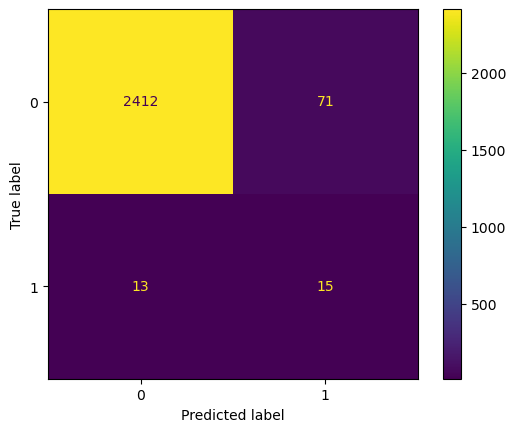

Best Threshold=0.020116, G-Mean=0.890


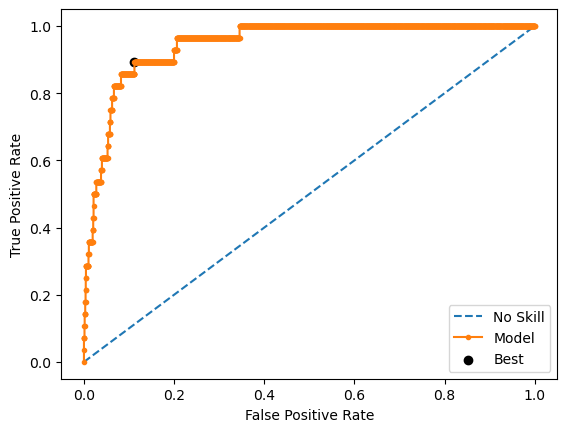

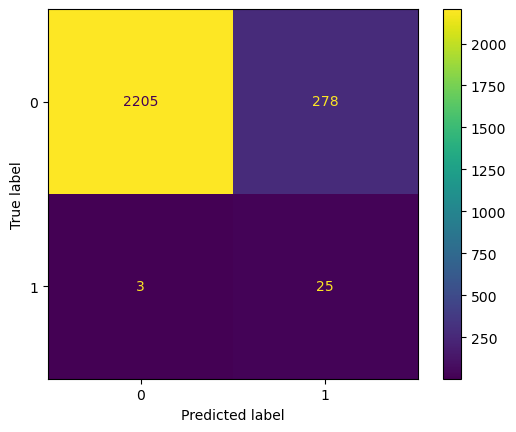

Accuracy threshold: 0.8881
F1 score threshold: 0.1511
MCC score: 0.2517
              precision    recall  f1-score   support

           0       1.00      0.89      0.94      2483
           1       0.08      0.89      0.15        28

    accuracy                           0.89      2511
   macro avg       0.54      0.89      0.55      2511
weighted avg       0.99      0.89      0.93      2511

Optimal threshold: 0.5


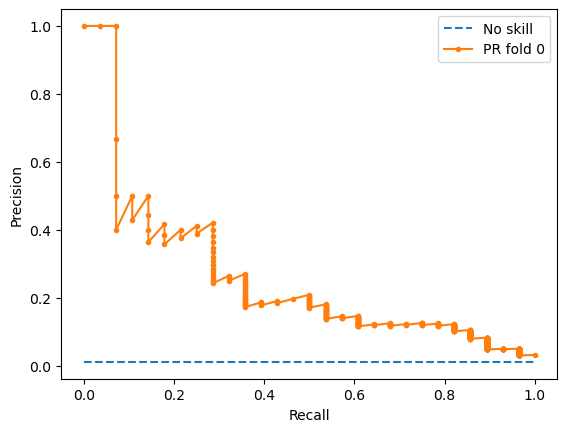

1it [00:01,  1.80s/it]/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/sklearn.py:736: UserWarning:

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
ROC/AUC: 0.965
Accuracy: 0.959
F1 score: 0.2695
MCC score: 0.3297
              precision    recall  f1-score   support

           0       1.00      0.96      0.98      2483
           1       0.17      0.70      0.27        27

    accuracy                           0.96      2510
   macro avg       0.58      0.83      0.62      2510
weighted avg       0.99      0.96      0.97      2510



<Figure size 640x480 with 0 Axes>

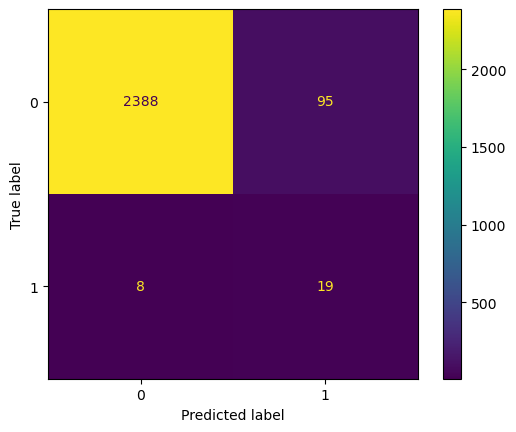

Best Threshold=0.104879, G-Mean=0.923


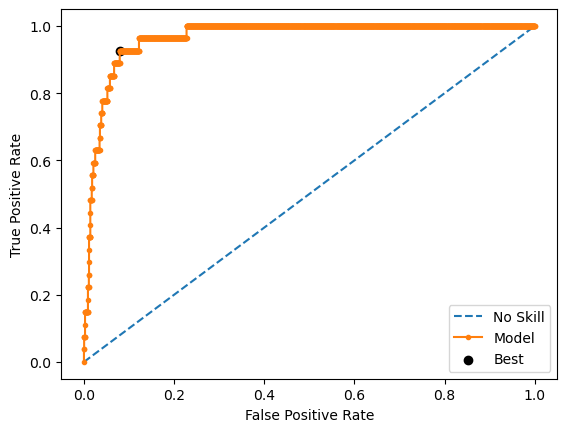

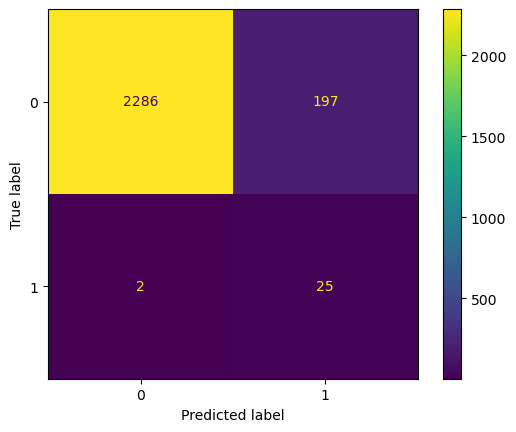

Accuracy threshold: 0.9207
F1 score threshold: 0.2008
MCC score: 0.3076
              precision    recall  f1-score   support

           0       1.00      0.92      0.96      2483
           1       0.11      0.93      0.20        27

    accuracy                           0.92      2510
   macro avg       0.56      0.92      0.58      2510
weighted avg       0.99      0.92      0.95      2510

Optimal threshold: 0.5


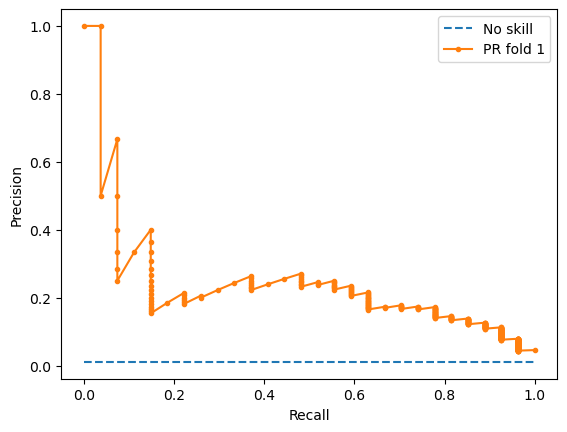

2it [00:03,  1.63s/it]/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/lightgbm/sklearn.py:736: UserWarning:

'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.



[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
ROC/AUC: 0.9491
Accuracy: 0.9677
F1 score: 0.2569
MCC score: 0.285
              precision    recall  f1-score   support

           0       0.99      0.97      0.98      2483
           1       0.17      0.52      0.26        27

    accuracy                           0.97      2510
   macro avg       0.58      0.75      0.62      2510
weighted avg       0.99      0.97      0.98      2510



<Figure size 640x480 with 0 Axes>

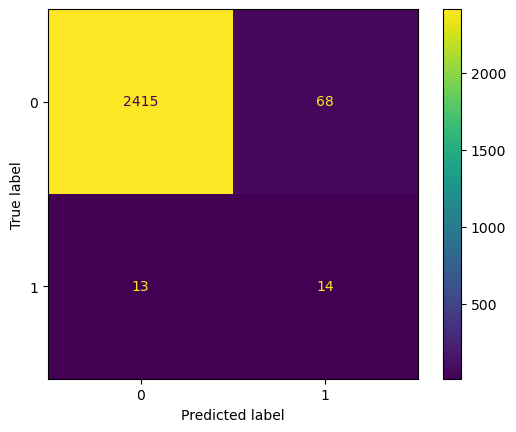

Best Threshold=0.137702, G-Mean=0.912


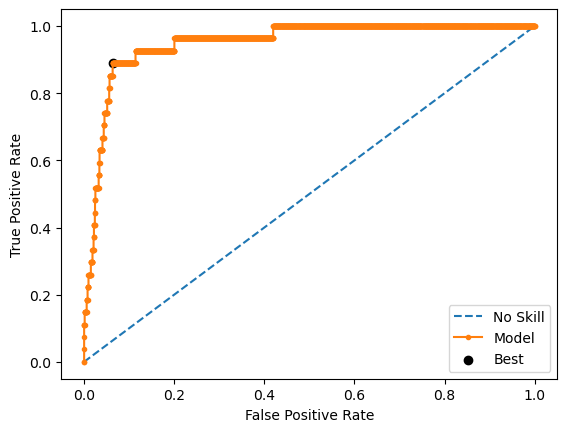

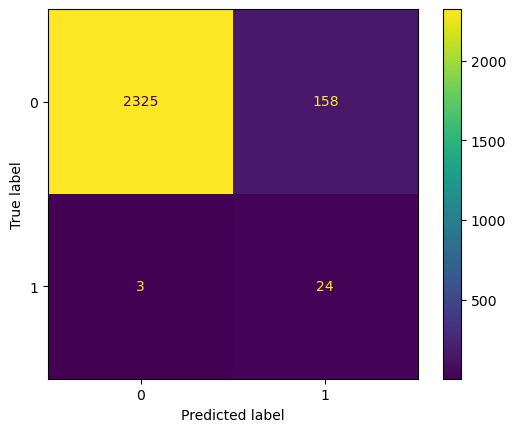

Accuracy threshold: 0.9359
F1 score threshold: 0.2297
MCC score: 0.3283
              precision    recall  f1-score   support

           0       1.00      0.94      0.97      2483
           1       0.13      0.89      0.23        27

    accuracy                           0.94      2510
   macro avg       0.57      0.91      0.60      2510
weighted avg       0.99      0.94      0.96      2510

Optimal threshold: 0.5


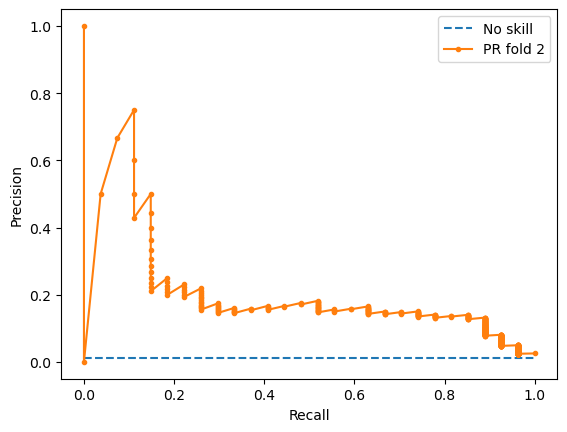

3it [00:05,  1.73s/it]


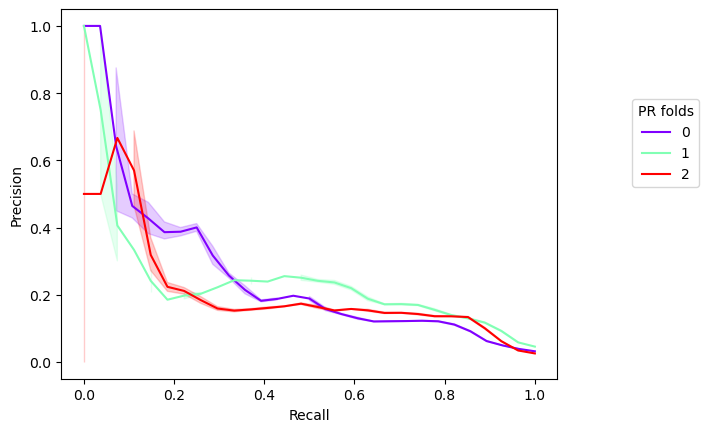

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warn

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/3447619090.py:221: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



<Figure size 640x480 with 0 Axes>

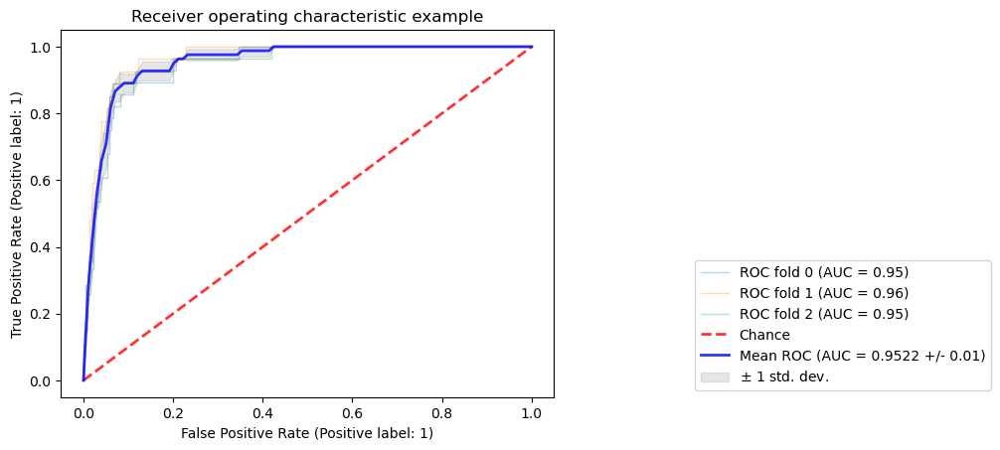

In [48]:
try:
    logged_model = f"runs:/{lgbm_run_id}/LGBM_model"
    lgbm_opt_from_pickle = mlflow.sklearn.load_model(logged_model)

except Exception:
    filepath_lgbm = os.path.join(path_folder, "models/lgbm_opt_from_pickle.pkl")
    with open(filepath_lgbm, 'rb') as fp_lgbm:
        lgbm_opt_from_pickle = pickle.load(fp_lgbm)
    lgbm_opt_from_pickle.fit(X_train_mod, y_train)

lgbm_opt_res, lgbm_opt_threshold, lgbm_pr_data_train, lgbm_roc_data_train  = train_diag_mlflow(
        lgbm_opt_from_pickle, X_train_mod, y_train, n_splits, "LGBM_opt_optimized"
)

### AdaBoost hyperparameter

In [49]:
ada_mod = AdaBoostClassifier(random_state=42)

param_grid_ada = {"n_estimators": [10, 20, 50, 250, 1000], "learning_rate": [0.01, 0.05, 0.1]}

ada_mod_search, best_params_ada = model_hyp_para(ada_mod, param_grid_ada, X_train_mod, y_train, 2, 2, "AdaBoostClassifier")

2024/07/23 15:09:22 INFO mlflow.tracking.fluent: Experiment with name 'AdaBoostClassifier_experiment_20240723_150921' does not exist. Creating a new experiment.


artifact uri: mlflow-artifacts:/634205408609816538/b45a1b7bf17345159b8853a5e900068b/artifacts
Run id: b45a1b7bf17345159b8853a5e900068b
Target prop 1.09 % of the test dataset
Target prop 50.0 % of the test dataset
Target prop 1.09 % of the test dataset
Target prop 50.0 % of the test dataset
Best estimator AdaBoostClassifier(learning_rate=0.1, n_estimators=1000, random_state=42)
Best score 0.9898554472216889
Best parameters {'learning_rate': 0.1, 'n_estimators': 1000}
Accuracy 0.947144754316069


In [50]:
ada_model = AdaBoostClassifier(**best_params_ada)
ada_model.fit(X_train_mod, y_train)
mlflow.sklearn.log_model(ada_model, "AdaBoostClassifier_model")

print("artifact uri:", mlflow.get_artifact_uri())
ada_run_id = mlflow.active_run().info.run_id
print("Run id:", ada_run_id)
mlflow.end_run()

artifact uri: mlflow-artifacts:/634205408609816538/88698740809b4be4a3f40c4eeba5d55f/artifacts
Run id: 88698740809b4be4a3f40c4eeba5d55f


In [51]:
filepath_ada = os.path.join(path_folder, "models/ada_opt_from_pickle.pkl")
pickle.dump(ada_model, open(filepath_ada, 'wb'))

2024/07/23 15:10:32 INFO mlflow.tracking.fluent: Experiment with name 'AdaBoost_optimized_20240723_151032' does not exist. Creating a new experiment.
0it [00:00, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
ROC/AUC: 0.9456
Accuracy: 0.9665
F1 score: 0.2632
MCC score: 0.2928
              precision    recall  f1-score   support

           0       0.99      0.97      0.98      2483
           1       0.17      0.54      0.26        28

    accuracy                           0.97      2511
   macro avg       0.58      0.75      0.62      2511
weighted avg       0.99      0.97      0.97      2511



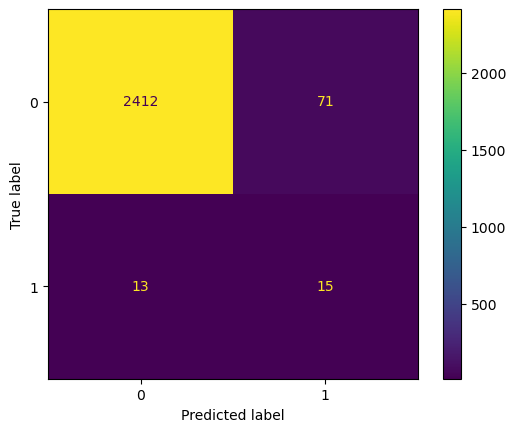

Best Threshold=0.020116, G-Mean=0.890


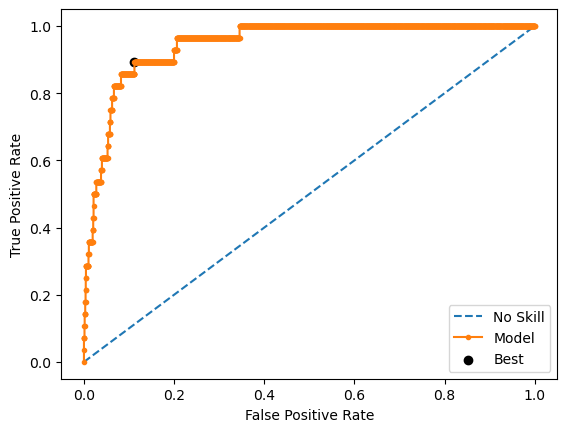

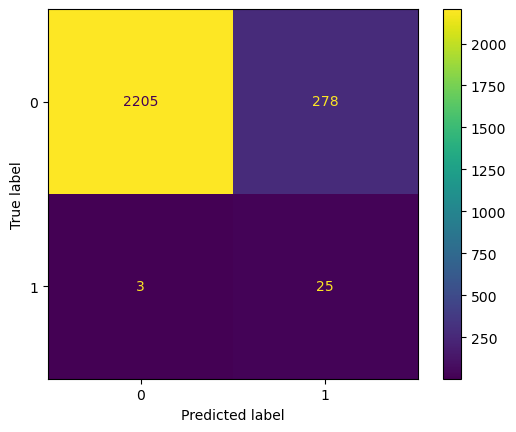

Accuracy threshold: 0.8881
F1 score threshold: 0.1511
MCC score: 0.2517
              precision    recall  f1-score   support

           0       1.00      0.89      0.94      2483
           1       0.08      0.89      0.15        28

    accuracy                           0.89      2511
   macro avg       0.54      0.89      0.55      2511
weighted avg       0.99      0.89      0.93      2511

Optimal threshold: 0.5


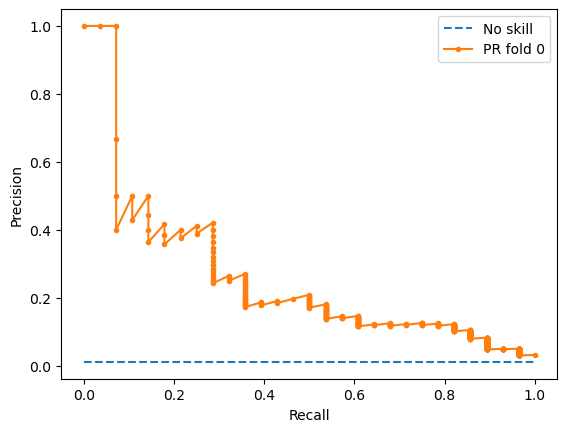

1it [00:02,  2.35s/it]

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
ROC/AUC: 0.965
Accuracy: 0.959
F1 score: 0.2695
MCC score: 0.3297
              precision    recall  f1-score   support

           0       1.00      0.96      0.98      2483
           1       0.17      0.70      0.27        27

    accuracy                           0.96      2510
   macro avg       0.58      0.83      0.62      2510
weighted avg       0.99      0.96      0.97      2510



<Figure size 640x480 with 0 Axes>

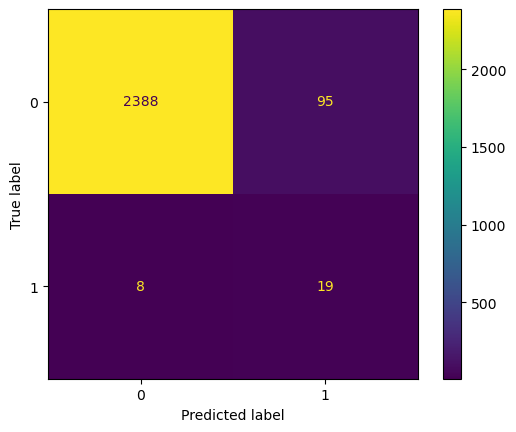

Best Threshold=0.104879, G-Mean=0.923


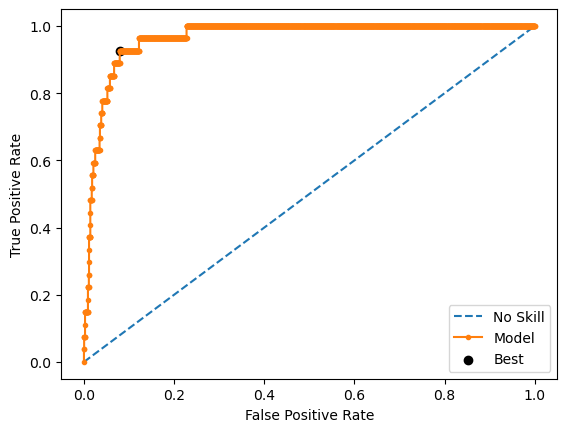

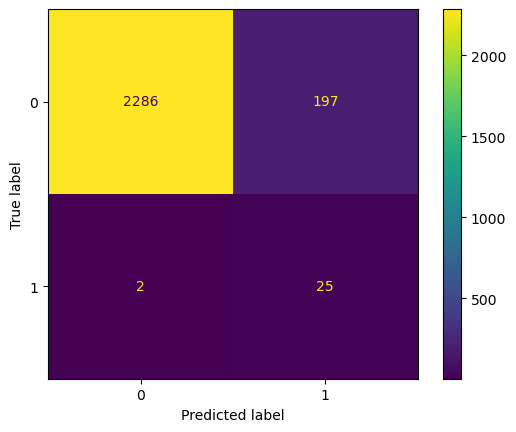

Accuracy threshold: 0.9207
F1 score threshold: 0.2008
MCC score: 0.3076
              precision    recall  f1-score   support

           0       1.00      0.92      0.96      2483
           1       0.11      0.93      0.20        27

    accuracy                           0.92      2510
   macro avg       0.56      0.92      0.58      2510
weighted avg       0.99      0.92      0.95      2510

Optimal threshold: 0.5


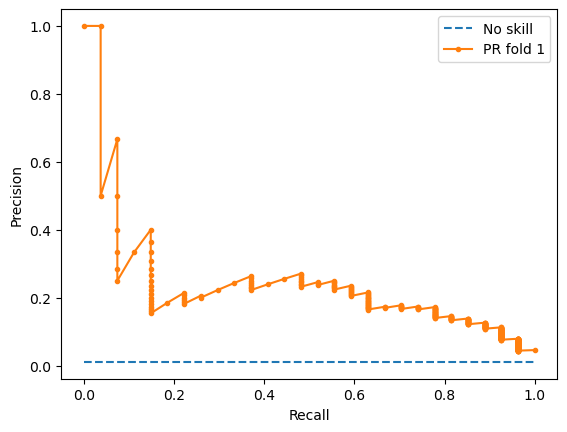

2it [00:04,  1.96s/it]

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
ROC/AUC: 0.9491
Accuracy: 0.9677
F1 score: 0.2569
MCC score: 0.285
              precision    recall  f1-score   support

           0       0.99      0.97      0.98      2483
           1       0.17      0.52      0.26        27

    accuracy                           0.97      2510
   macro avg       0.58      0.75      0.62      2510
weighted avg       0.99      0.97      0.98      2510



<Figure size 640x480 with 0 Axes>

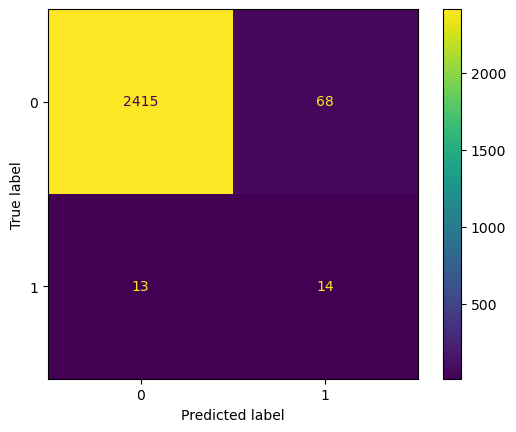

Best Threshold=0.137702, G-Mean=0.912


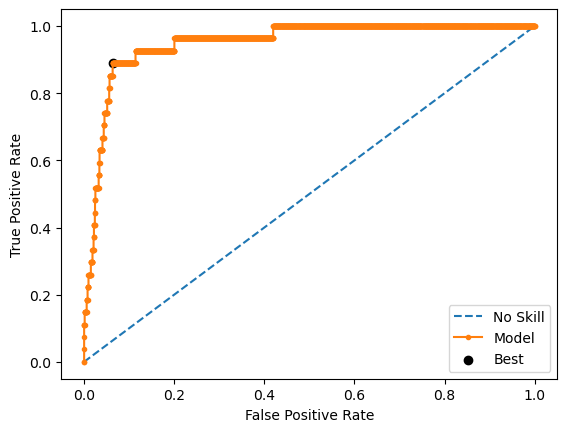

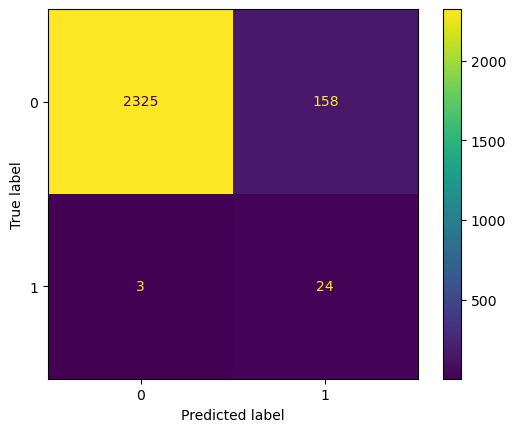

Accuracy threshold: 0.9359
F1 score threshold: 0.2297
MCC score: 0.3283
              precision    recall  f1-score   support

           0       1.00      0.94      0.97      2483
           1       0.13      0.89      0.23        27

    accuracy                           0.94      2510
   macro avg       0.57      0.91      0.60      2510
weighted avg       0.99      0.94      0.96      2510

Optimal threshold: 0.5


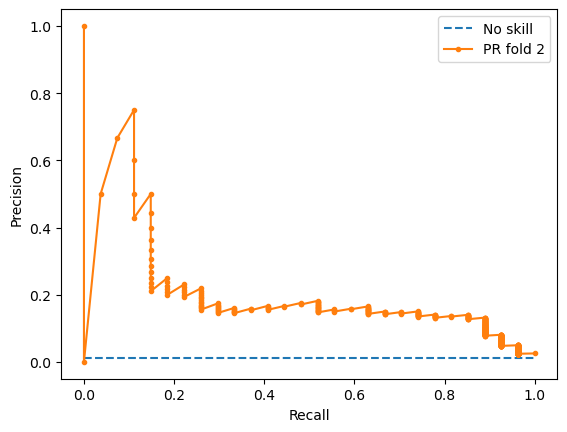

3it [00:05,  1.87s/it]


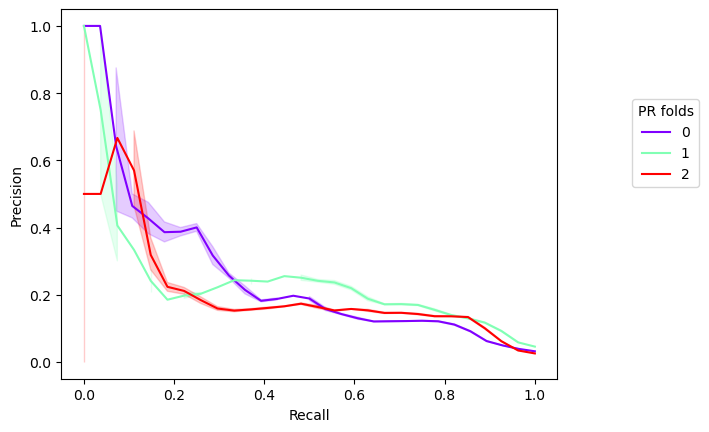

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/3447619090.py:221: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



<Figure size 640x480 with 0 Axes>

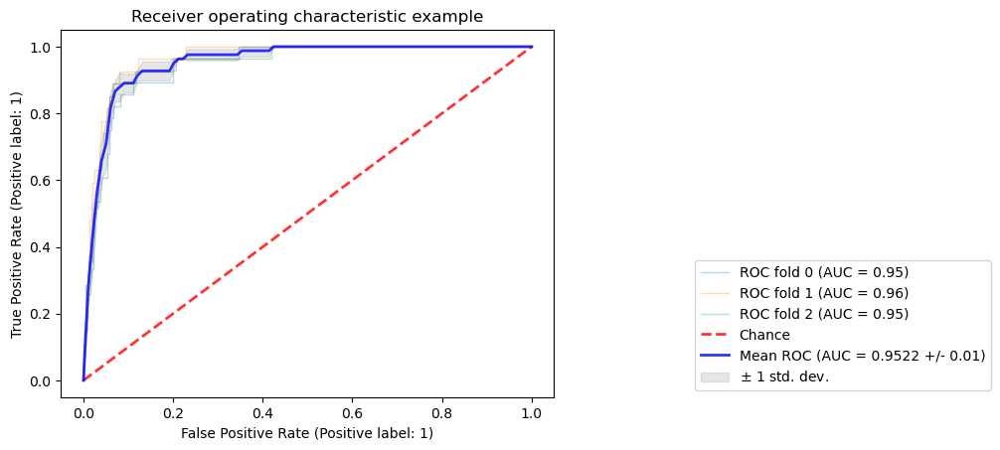

In [52]:
try:
    logged_model = f"runs:/{ada_run_id}/AdaBoostClassifier_model"
    ada_opt_from_pickle = mlflow.sklearn.load_model(logged_model)

except Exception:
    filepath_ada = os.path.join(path_folder, "models/ada_opt_from_pickle.pkl")
    with open(filepath_ada, 'rb') as fp_ada:
        ada_opt_from_pickle = pickle.load(fp_ada)
    ada_opt_from_pickle.fit(X_train_mod, y_train)

ada_res, ada_threshold, ada_pr_data_train, ada_roc_data_train  = train_diag_mlflow(
        lgbm_opt_from_pickle, X_train_mod, y_train, n_splits, "AdaBoost_optimized"
)

### CatBoost model

In [53]:
%time

cb_mod = CatBoostClassifier()

param_grid_cb = {
    "max_depth": [3, 5, 7],
    "n_estimators" : [100, 200, 300],
    "learning_rate" : [0.01, 0.03, 0.05]
}

cb_mod_search, best_params_cb = model_hyp_para(cb_mod, param_grid_cb, X_train_mod, y_train, 2, 2, "CatBoostClassifier")

CPU times: user 3 µs, sys: 1e+03 ns, total: 4 µs
Wall time: 7.87 µs


2024/07/23 15:10:45 INFO mlflow.tracking.fluent: Experiment with name 'CatBoostClassifier_experiment_20240723_151044' does not exist. Creating a new experiment.


artifact uri: mlflow-artifacts:/900143111479644843/d6bd3f6d690e41ee8b9f3116a4886fe3/artifacts
Run id: d6bd3f6d690e41ee8b9f3116a4886fe3
Target prop 1.09 % of the test dataset
Target prop 50.0 % of the test dataset
0:	learn: 0.6861694	total: 57.1ms	remaining: 5.65s
0:	learn: 0.6861686	total: 56.1ms	remaining: 5.56s
0:	learn: 0.6822672	total: 58.2ms	remaining: 11.6s
0:	learn: 0.6822280	total: 58.3ms	remaining: 11.6s
0:	learn: 0.6862025	total: 59.5ms	remaining: 5.89s
0:	learn: 0.6822672	total: 58.5ms	remaining: 17.5s
1:	learn: 0.6795505	total: 58.8ms	remaining: 2.88s
1:	learn: 0.6792934	total: 58.7ms	remaining: 2.88s
0:	learn: 0.6822280	total: 57.5ms	remaining: 17.2s
2:	learn: 0.6726594	total: 60.4ms	remaining: 1.95s
1:	learn: 0.6705586	total: 61.3ms	remaining: 6.07s
1:	learn: 0.6698815	total: 61.9ms	remaining: 6.13s
0:	learn: 0.6861892	total: 60.1ms	remaining: 5.95s
1:	learn: 0.6790650	total: 63.4ms	remaining: 3.1s
3:	learn: 0.6657758	total: 62.2ms	remaining: 1.49s
2:	learn: 0.6724275	tot

In [54]:
cb_model = CatBoostClassifier(**best_params_cb)
cb_model.fit(X_train_mod, y_train)
mlflow.sklearn.log_model(cb_model, "CatBoostClassifier_model")

print("artifact uri:", mlflow.get_artifact_uri())
cb_run_id = mlflow.active_run().info.run_id
print("Run id:", cb_run_id)
mlflow.end_run()

0:	learn: 0.5704293	total: 7.56ms	remaining: 2.26s
1:	learn: 0.4819041	total: 14.9ms	remaining: 2.22s
2:	learn: 0.4001313	total: 26.1ms	remaining: 2.58s
3:	learn: 0.3336379	total: 38.1ms	remaining: 2.82s
4:	learn: 0.2884783	total: 43.5ms	remaining: 2.57s
5:	learn: 0.2445012	total: 56.4ms	remaining: 2.76s
6:	learn: 0.2148631	total: 59.2ms	remaining: 2.48s
7:	learn: 0.1854363	total: 65.4ms	remaining: 2.39s
8:	learn: 0.1539151	total: 71.4ms	remaining: 2.31s
9:	learn: 0.1329804	total: 77.5ms	remaining: 2.25s
10:	learn: 0.1174472	total: 86.3ms	remaining: 2.27s
11:	learn: 0.1039045	total: 94.5ms	remaining: 2.27s
12:	learn: 0.0902524	total: 102ms	remaining: 2.26s
13:	learn: 0.0812774	total: 117ms	remaining: 2.39s
14:	learn: 0.0753290	total: 128ms	remaining: 2.42s
15:	learn: 0.0683615	total: 135ms	remaining: 2.39s
16:	learn: 0.0638787	total: 145ms	remaining: 2.41s
17:	learn: 0.0600151	total: 153ms	remaining: 2.4s
18:	learn: 0.0559505	total: 161ms	remaining: 2.38s
19:	learn: 0.0523812	total: 16

In [55]:
filepath_cb = os.path.join(path_folder, "models/cb_opt_from_pickle.pkl")
pickle.dump(cb_model, open(filepath_cb, 'wb'))

2024/07/23 15:11:40 INFO mlflow.tracking.fluent: Experiment with name 'CatBoostClassifier_optimized_20240723_151140' does not exist. Creating a new experiment.
0it [00:00, ?it/s]

ROC/AUC: 0.9256
Accuracy: 0.9773
F1 score: 0.2785
MCC score: 0.2805
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      2483
           1       0.22      0.39      0.28        28

    accuracy                           0.98      2511
   macro avg       0.60      0.69      0.63      2511
weighted avg       0.98      0.98      0.98      2511



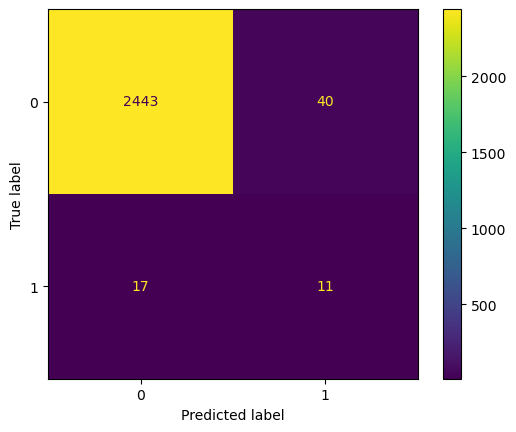

Best Threshold=0.022486, G-Mean=0.875


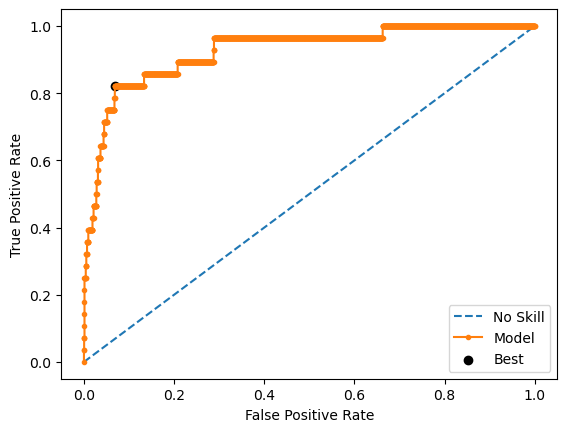

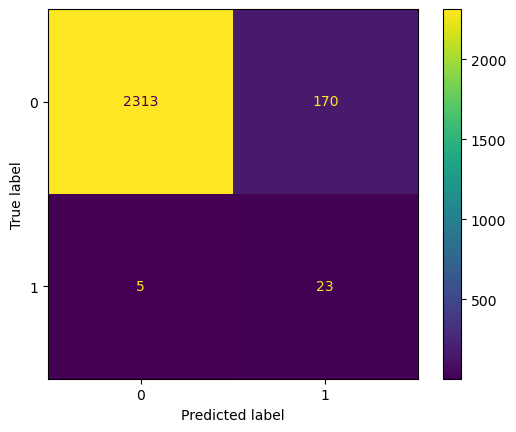

Accuracy threshold: 0.9303
F1 score threshold: 0.2081
MCC score: 0.2968
              precision    recall  f1-score   support

           0       1.00      0.93      0.96      2483
           1       0.12      0.82      0.21        28

    accuracy                           0.93      2511
   macro avg       0.56      0.88      0.59      2511
weighted avg       0.99      0.93      0.96      2511

Optimal threshold: 0.5


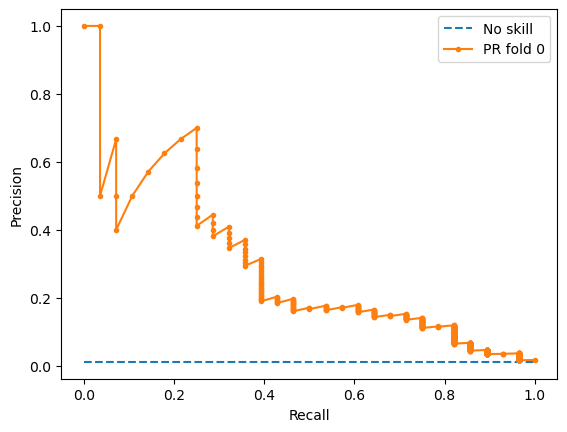

1it [00:03,  3.00s/it]

ROC/AUC: 0.9457
Accuracy: 0.9745
F1 score: 0.2727
MCC score: 0.2845
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      2483
           1       0.20      0.44      0.27        27

    accuracy                           0.97      2510
   macro avg       0.60      0.71      0.63      2510
weighted avg       0.99      0.97      0.98      2510



<Figure size 640x480 with 0 Axes>

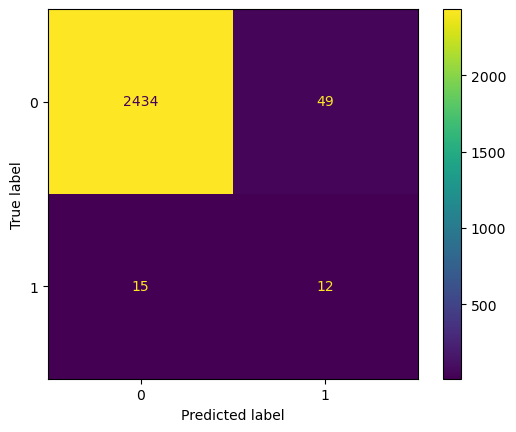

Best Threshold=0.027801, G-Mean=0.876


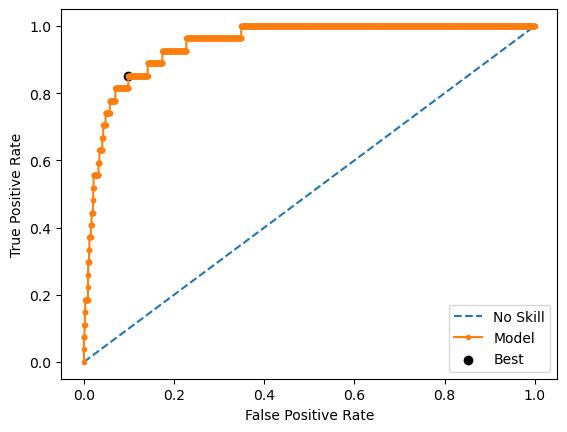

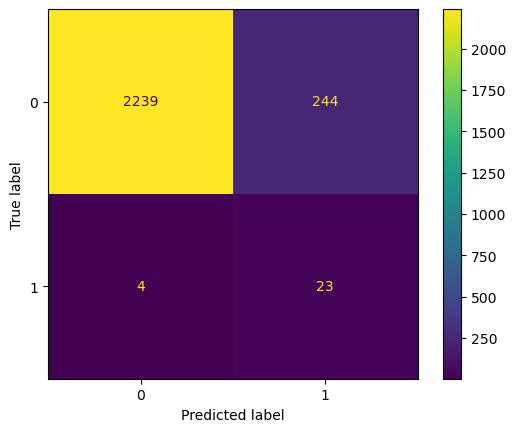

Accuracy threshold: 0.9012
F1 score threshold: 0.1565
MCC score: 0.2521
              precision    recall  f1-score   support

           0       1.00      0.90      0.95      2483
           1       0.09      0.85      0.16        27

    accuracy                           0.90      2510
   macro avg       0.54      0.88      0.55      2510
weighted avg       0.99      0.90      0.94      2510

Optimal threshold: 0.5


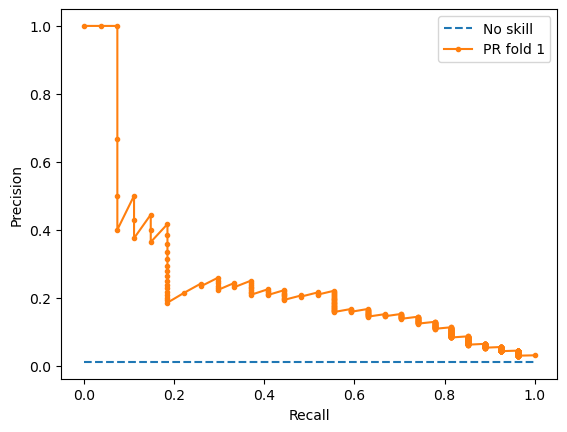

2it [00:05,  3.00s/it]

ROC/AUC: 0.9283
Accuracy: 0.9761
F1 score: 0.2857
MCC score: 0.2952
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      2483
           1       0.21      0.44      0.29        27

    accuracy                           0.98      2510
   macro avg       0.60      0.71      0.64      2510
weighted avg       0.99      0.98      0.98      2510



<Figure size 640x480 with 0 Axes>

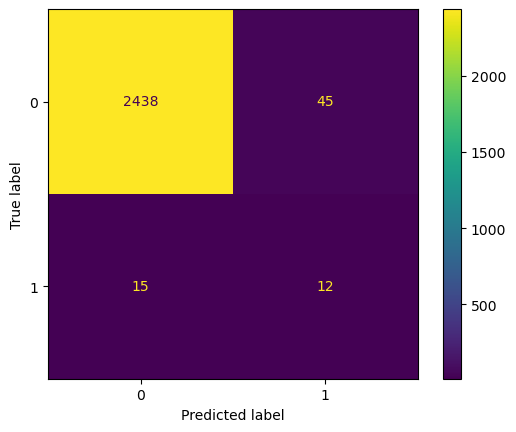

Best Threshold=0.012809, G-Mean=0.901


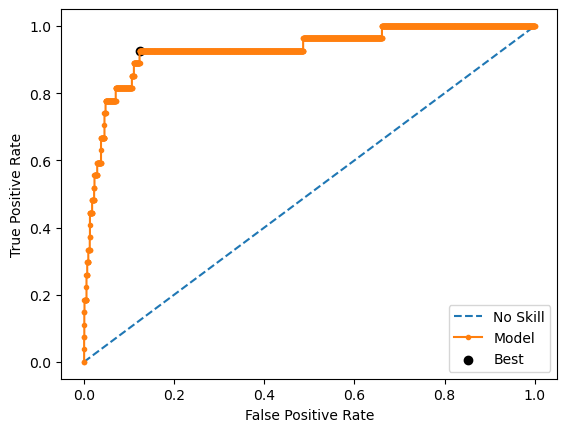

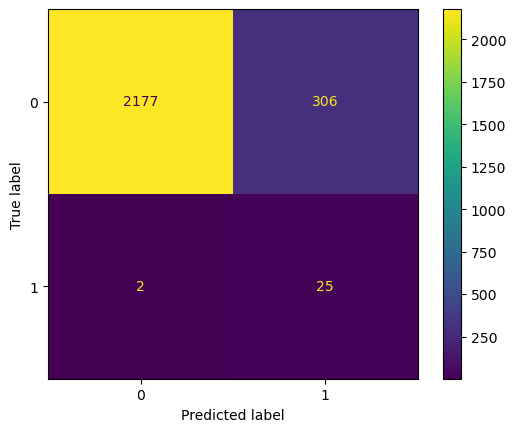

Accuracy threshold: 0.8773
F1 score threshold: 0.1397
MCC score: 0.2447
              precision    recall  f1-score   support

           0       1.00      0.88      0.93      2483
           1       0.08      0.93      0.14        27

    accuracy                           0.88      2510
   macro avg       0.54      0.90      0.54      2510
weighted avg       0.99      0.88      0.93      2510

Optimal threshold: 0.5


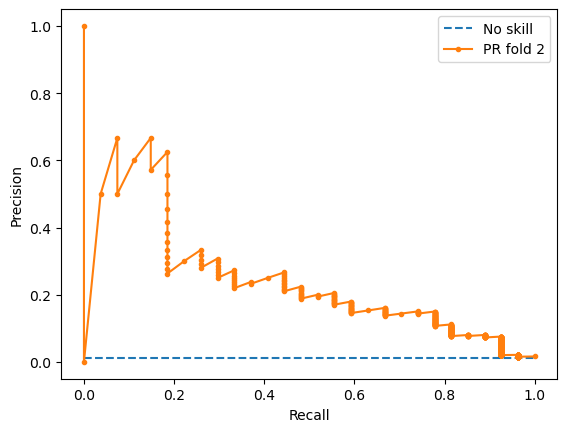

3it [00:10,  3.41s/it]


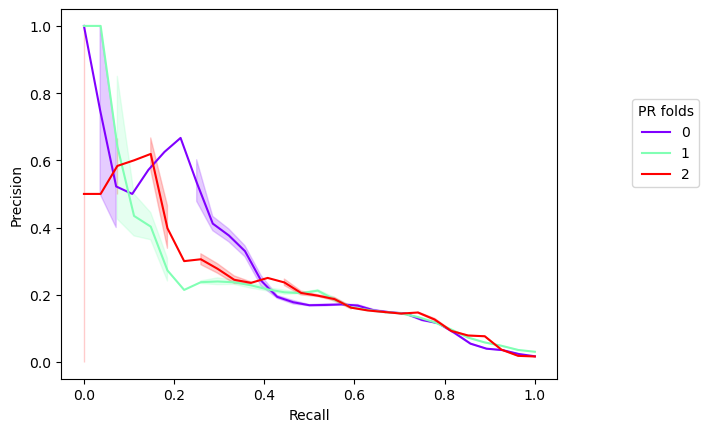

0:	learn: 0.6024875	total: 8.28ms	remaining: 2.47s
1:	learn: 0.5157829	total: 14.3ms	remaining: 2.13s
2:	learn: 0.4535966	total: 20.7ms	remaining: 2.05s
3:	learn: 0.3950665	total: 27.8ms	remaining: 2.06s
4:	learn: 0.3451934	total: 50.2ms	remaining: 2.96s
5:	learn: 0.3031553	total: 63.3ms	remaining: 3.1s
6:	learn: 0.2712033	total: 84.8ms	remaining: 3.55s
7:	learn: 0.2542587	total: 95.8ms	remaining: 3.5s
8:	learn: 0.2332665	total: 108ms	remaining: 3.48s
9:	learn: 0.2176147	total: 129ms	remaining: 3.73s
10:	learn: 0.1991246	total: 140ms	remaining: 3.68s
11:	learn: 0.1864939	total: 151ms	remaining: 3.63s
12:	learn: 0.1748185	total: 162ms	remaining: 3.58s
13:	learn: 0.1632156	total: 173ms	remaining: 3.54s
14:	learn: 0.1520272	total: 183ms	remaining: 3.48s
15:	learn: 0.1425392	total: 204ms	remaining: 3.62s
16:	learn: 0.1352655	total: 230ms	remaining: 3.83s
17:	learn: 0.1289571	total: 240ms	remaining: 3.77s
18:	learn: 0.1240114	total: 252ms	remaining: 3.73s
19:	learn: 0.1195872	total: 266ms	r

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



24:	learn: 0.1509266	total: 128ms	remaining: 1.41s
25:	learn: 0.1463667	total: 140ms	remaining: 1.47s
26:	learn: 0.1426486	total: 151ms	remaining: 1.53s
27:	learn: 0.1394554	total: 159ms	remaining: 1.55s
28:	learn: 0.1363340	total: 165ms	remaining: 1.54s
29:	learn: 0.1332631	total: 172ms	remaining: 1.54s
30:	learn: 0.1291472	total: 178ms	remaining: 1.54s
31:	learn: 0.1271282	total: 184ms	remaining: 1.54s
32:	learn: 0.1250315	total: 218ms	remaining: 1.76s
33:	learn: 0.1218189	total: 228ms	remaining: 1.78s
34:	learn: 0.1203197	total: 241ms	remaining: 1.82s
35:	learn: 0.1183050	total: 259ms	remaining: 1.9s
36:	learn: 0.1156914	total: 275ms	remaining: 1.95s
37:	learn: 0.1138169	total: 282ms	remaining: 1.94s
38:	learn: 0.1119999	total: 289ms	remaining: 1.93s
39:	learn: 0.1088746	total: 295ms	remaining: 1.92s
40:	learn: 0.1072063	total: 301ms	remaining: 1.9s
41:	learn: 0.1052565	total: 309ms	remaining: 1.9s
42:	learn: 0.1039903	total: 316ms	remaining: 1.89s
43:	learn: 0.1016008	total: 324ms	

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



11:	learn: 0.2327905	total: 64.2ms	remaining: 1.54s
12:	learn: 0.2162496	total: 70.4ms	remaining: 1.55s
13:	learn: 0.2042451	total: 77ms	remaining: 1.57s
14:	learn: 0.1915363	total: 82.7ms	remaining: 1.57s
15:	learn: 0.1798060	total: 89ms	remaining: 1.58s
16:	learn: 0.1726123	total: 95.4ms	remaining: 1.59s
17:	learn: 0.1647939	total: 101ms	remaining: 1.58s
18:	learn: 0.1561557	total: 106ms	remaining: 1.57s
19:	learn: 0.1502559	total: 111ms	remaining: 1.55s
20:	learn: 0.1441506	total: 115ms	remaining: 1.53s
21:	learn: 0.1396936	total: 120ms	remaining: 1.52s
22:	learn: 0.1363139	total: 125ms	remaining: 1.5s
23:	learn: 0.1319163	total: 130ms	remaining: 1.49s
24:	learn: 0.1287159	total: 135ms	remaining: 1.49s
25:	learn: 0.1239168	total: 140ms	remaining: 1.47s
26:	learn: 0.1218754	total: 144ms	remaining: 1.46s
27:	learn: 0.1193711	total: 149ms	remaining: 1.45s
28:	learn: 0.1166812	total: 154ms	remaining: 1.44s
29:	learn: 0.1147788	total: 158ms	remaining: 1.42s
30:	learn: 0.1120876	total: 16

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/3447619090.py:221: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



<Figure size 640x480 with 0 Axes>

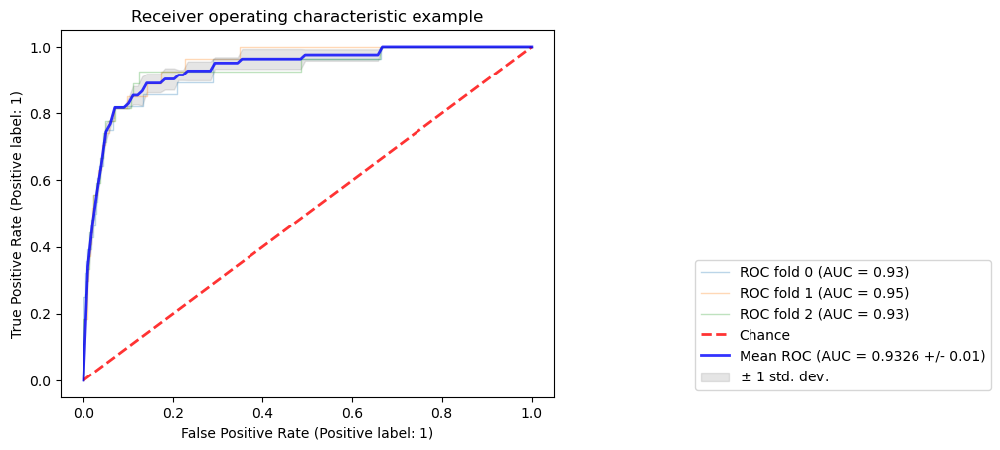

In [56]:
try:
    logged_model = f"runs:/{cb_run_id}/CatBoostClassifier_model"
    cb_opt_from_pickle = mlflow.sklearn.load_model(logged_model)

except Exception:
    filepath_cb = os.path.join(path_folder, "models/cb_opt_from_pickle.pkl")
    with open(filepath_cb, 'rb') as fp_cb:
        cb_opt_from_pickle = pickle.load(fp_cb)
    cb_opt_from_pickle.fit(X_train_mod, y_train)

cb_res, cb_threshold, cb_pr_data_train, cb_roc_data_train  = train_diag_mlflow(
    cb_opt_from_pickle, X_train_mod, y_train, n_splits, "CatBoostClassifier_optimized"
)

### Voting classifier

In [57]:
print(best_params_lgbm)
print(best_params_xgb)
print(best_params_ada)

# {'max_depth': 12, 'num_leaves': 50, 'learning_rate': 0.09202813610258713, 'feature_fraction': 0.3477344270507926, 'bagging_fraction': 0.496931598099765, 'max_bin': 30, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}
# {'max_depth': 15, 'subsample': 0.785572407972861, 'learning_rate': 0.014989952006895096, 'min_child_weight': 7, 'alpha': 0.5293008998039456, 'lambda': 0.23203671515172095, 'gamma': 0.22717289522212977}
# {'learning_rate': 0.1, 'n_estimators': 1000}

{'max_depth': 12, 'num_leaves': 20, 'learning_rate': 0.09849676059689247, 'feature_fraction': 0.8139011359795677, 'bagging_fraction': 0.1526110822260948, 'max_bin': 40, 'min_data_in_leaf': 60, 'min_sum_hessian_in_leaf': 20}
{'max_depth': 13, 'subsample': 0.505910258269532, 'learning_rate': 0.011287686578096185, 'min_child_weight': 3, 'alpha': 0.7438040157619862, 'lambda': 0.9403599092155546, 'gamma': 0.5167711259686412}
{'learning_rate': 0.1, 'n_estimators': 1000}


2024/07/23 15:12:02 INFO mlflow.tracking.fluent: Experiment with name 'Voting_classifier_20240723_151202' does not exist. Creating a new experiment.
0it [00:00, ?it/s]

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
ROC/AUC: 0.9566
Accuracy: 0.961
F1 score: 0.2462
MCC score: 0.2855
              precision    recall  f1-score   support

           0       1.00      0.97      0.98      2483
           1       0.16      0.57      0.25        28

    accuracy                           0.96      2511
   macro avg       0.58      0.77      0.61      2511
weighted avg       0.99      0.96      0.97      2511



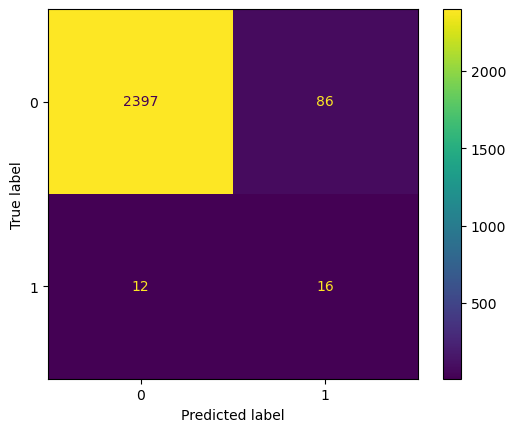

Best Threshold=0.222012, G-Mean=0.903


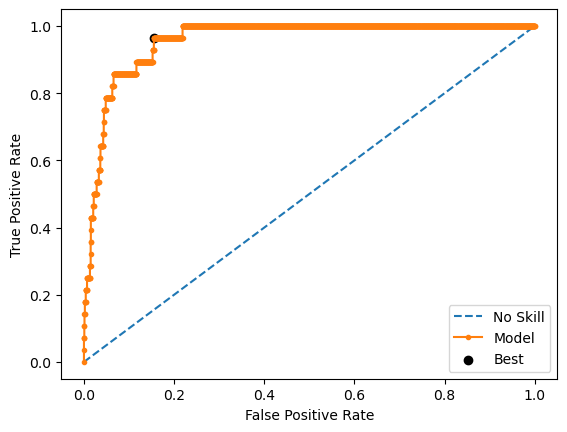

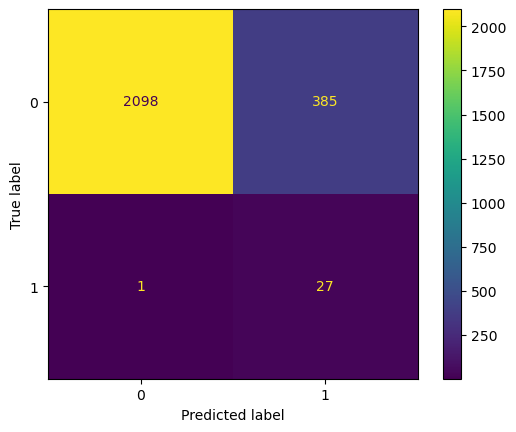

Accuracy threshold: 0.8463
F1 score threshold: 0.1227
MCC score: 0.2294
              precision    recall  f1-score   support

           0       1.00      0.84      0.92      2483
           1       0.07      0.96      0.12        28

    accuracy                           0.85      2511
   macro avg       0.53      0.90      0.52      2511
weighted avg       0.99      0.85      0.91      2511

Optimal threshold: 0.5


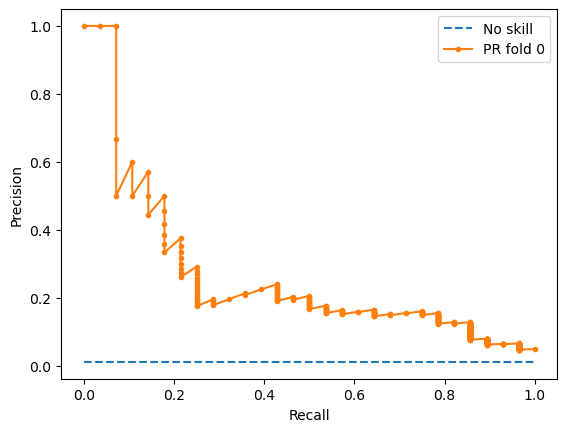

1it [00:15, 15.93s/it]

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
ROC/AUC: 0.9696
Accuracy: 0.9582
F1 score: 0.2857
MCC score: 0.3568
              precision    recall  f1-score   support

           0       1.00      0.96      0.98      2483
           1       0.17      0.78      0.29        27

    accuracy                           0.96      2510
   macro avg       0.59      0.87      0.63      2510
weighted avg       0.99      0.96      0.97      2510



<Figure size 640x480 with 0 Axes>

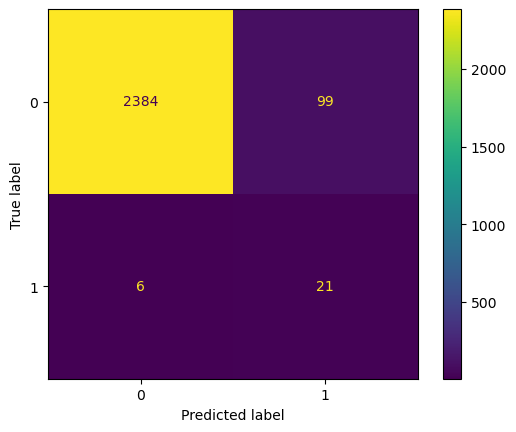

Best Threshold=0.262808, G-Mean=0.942


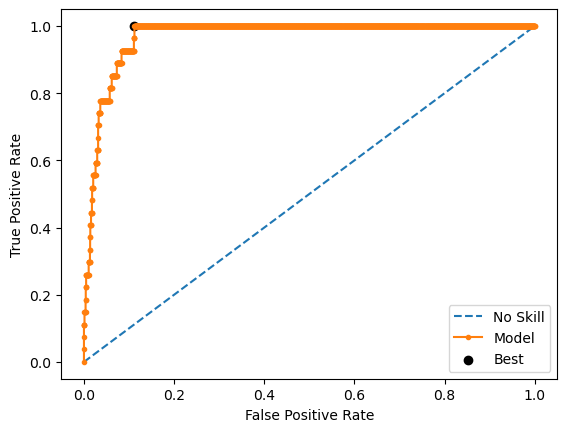

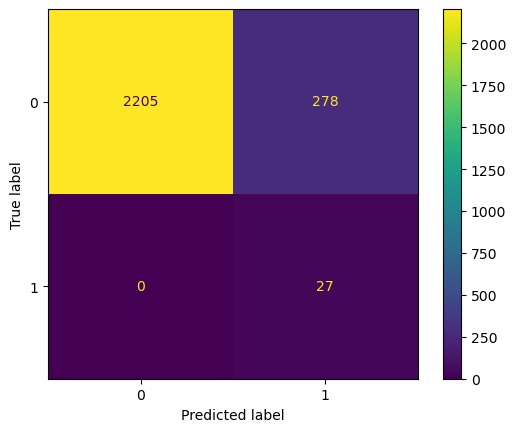

Accuracy threshold: 0.8892
F1 score threshold: 0.1627
MCC score: 0.2804
              precision    recall  f1-score   support

           0       1.00      0.89      0.94      2483
           1       0.09      1.00      0.16        27

    accuracy                           0.89      2510
   macro avg       0.54      0.94      0.55      2510
weighted avg       0.99      0.89      0.93      2510

Optimal threshold: 0.5


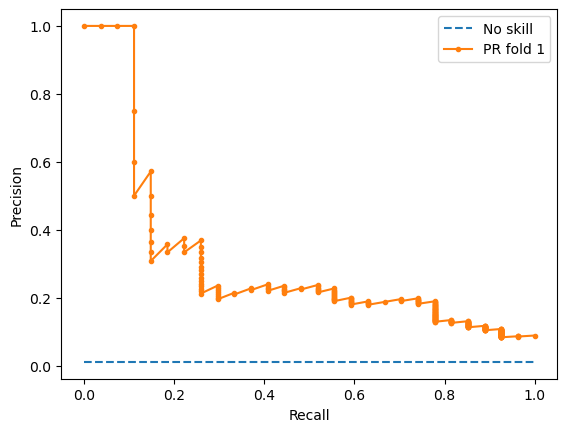

2it [00:31, 15.97s/it]

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20
ROC/AUC: 0.9493
Accuracy: 0.9641
F1 score: 0.25
MCC score: 0.2862
              precision    recall  f1-score   support

           0       1.00      0.97      0.98      2483
           1       0.16      0.56      0.25        27

    accuracy                           0.96      2510
   macro avg       0.58      0.76      0.62      2510
weighted avg       0.99      0.96      0.97      2510



<Figure size 640x480 with 0 Axes>

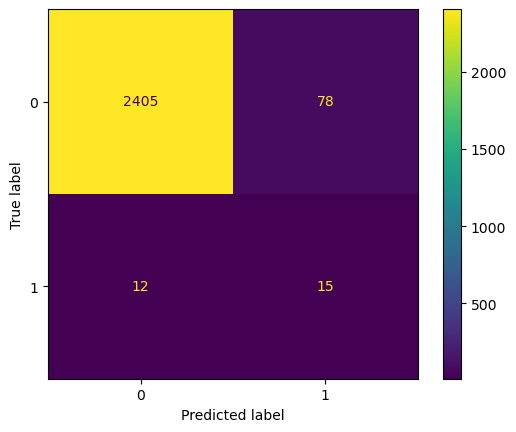

Best Threshold=0.259078, G-Mean=0.914


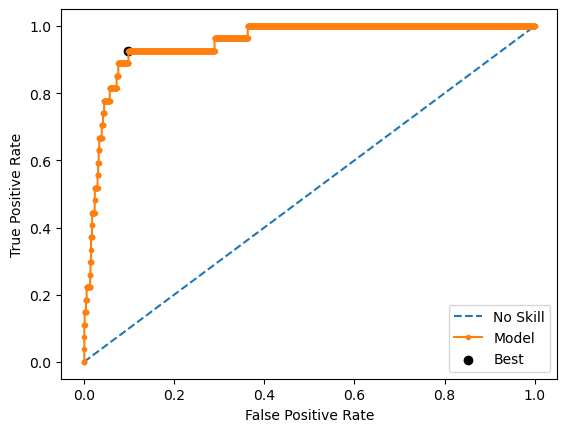

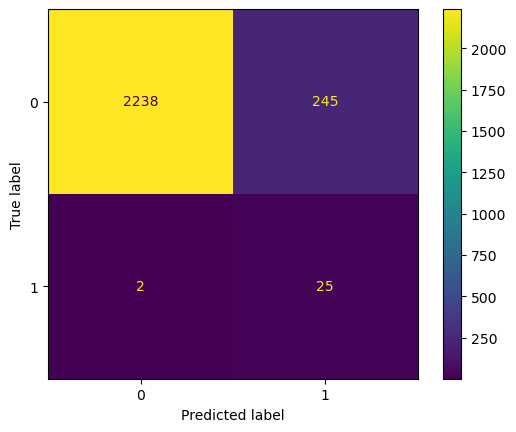

Accuracy threshold: 0.9016
F1 score threshold: 0.1684
MCC score: 0.2754
              precision    recall  f1-score   support

           0       1.00      0.90      0.95      2483
           1       0.09      0.93      0.17        27

    accuracy                           0.90      2510
   macro avg       0.55      0.91      0.56      2510
weighted avg       0.99      0.90      0.94      2510

Optimal threshold: 0.5


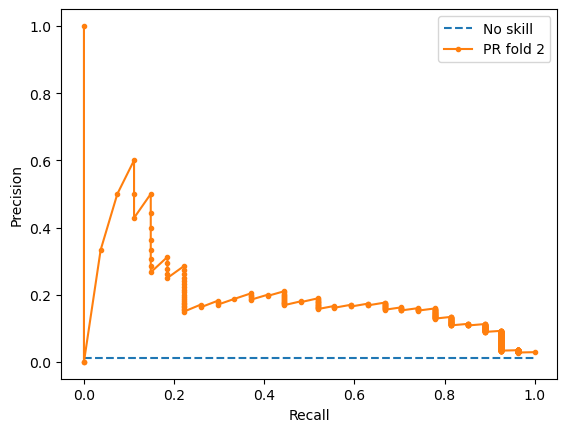

3it [00:47, 15.87s/it]


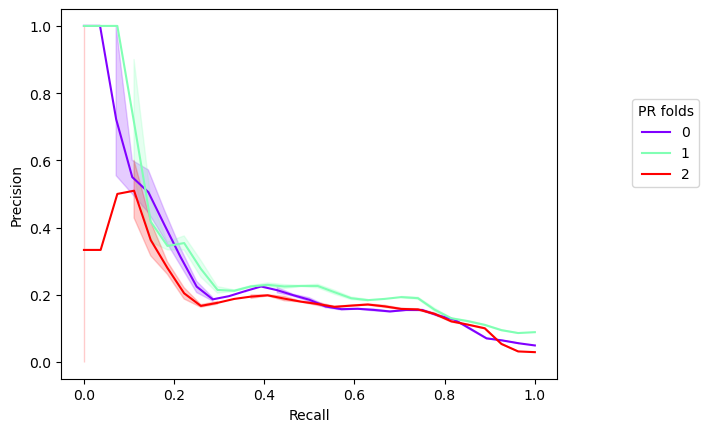

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.



[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_fraction is set=0.1526110822260948, subsample=1.0 will be ignored. Current value: bagging_fraction=0.1526110822260948
[LightGBM] [Warning] feature_fraction is set=0.8139011359795677, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8139011359795677
[LightGBM] [Warning] min_sum_hessian_in_leaf is set=20, min_child_weight=0.001 will be ignored. Current value: min_sum_hessian_in_leaf=20


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/utils/deprecation.py:87: FutureWarning:

Function plot_roc_curve is deprecated; Function :func:`plot_roc_curve` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: :meth:`sklearn.metric.RocCurveDisplay.from_predictions` or :meth:`sklearn.metric.RocCurveDisplay.from_estimator`.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/3447619090.py:221: UserWarning:

Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.



<Figure size 640x480 with 0 Axes>

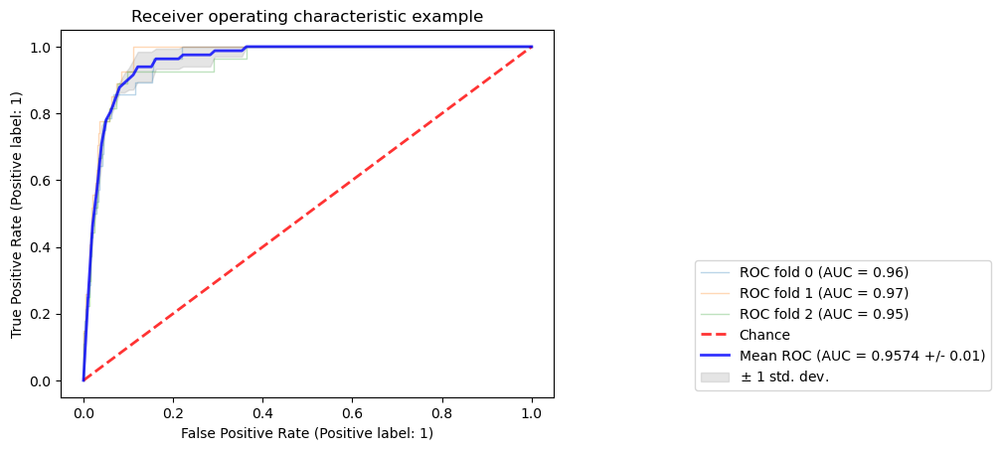

In [58]:
learner_1 = lgb.LGBMClassifier(
    max_depth=best_params_lgbm["max_depth"],
    num_leaves=best_params_lgbm["num_leaves"],
    learning_rate=best_params_lgbm["learning_rate"],
    feature_fraction=best_params_lgbm["feature_fraction"],
    bagging_fraction=best_params_lgbm["bagging_fraction"],
    max_bin=best_params_lgbm["max_bin"],
    min_data_in_leaf=best_params_lgbm["min_data_in_leaf"],
    min_sum_hessian_in_leaf=best_params_lgbm["min_sum_hessian_in_leaf"],
)
learner_2 = xgb.XGBClassifier(
    max_depth=best_params_xgb["max_depth"],
    subsample=best_params_xgb["subsample"],
    learning_rate=best_params_xgb["learning_rate"],
    min_child_weight=best_params_xgb["min_child_weight"],
    alpha=best_params_xgb["alpha"],
    gamma=best_params_xgb["gamma"],
)
learner_3 = AdaBoostClassifier(
    random_state=42, n_estimators=best_params_ada["n_estimators"], learning_rate=best_params_ada["learning_rate"]
)


# Instantiate the voting classifier
voting = VotingClassifier([("LGBM", learner_1), ("XGB", learner_2), ("Adaboost", learner_3)], voting="soft")

filepath_v = os.path.join(path_folder, "models/voting_pickle.pkl")
pickle.dump(voting, open(filepath_v, "wb"))

voting_res, voting_threshold, voting_pr_data_train, voting_roc_data_train  = train_diag_mlflow(
        voting, X_train_mod, y_train, n_splits, "Voting_classifier"
)

### Stacking

2024/07/23 15:13:35 INFO mlflow.tracking.fluent: Experiment with name 'Stacking_classifier_20240723_151335' does not exist. Creating a new experiment.
0it [00:00, ?it/s]

ROC/AUC: 0.9596
Accuracy: 0.9717
F1 score: 0.2828
MCC score: 0.3022
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      2483
           1       0.20      0.50      0.28        28

    accuracy                           0.97      2511
   macro avg       0.60      0.74      0.63      2511
weighted avg       0.99      0.97      0.98      2511



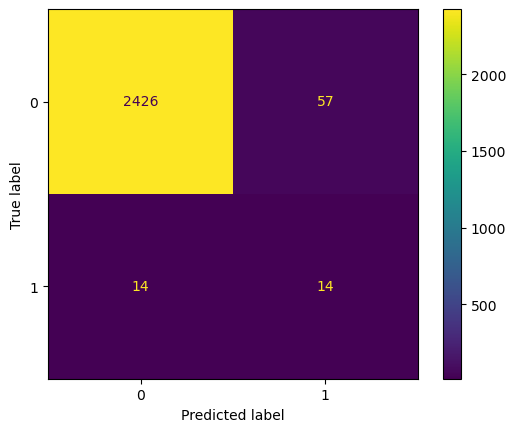

Best Threshold=0.000488, G-Mean=0.915


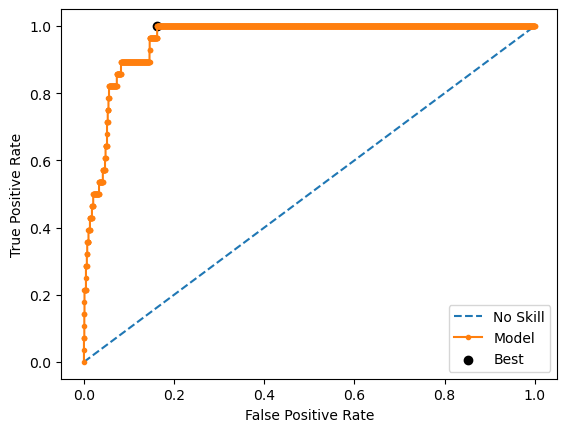

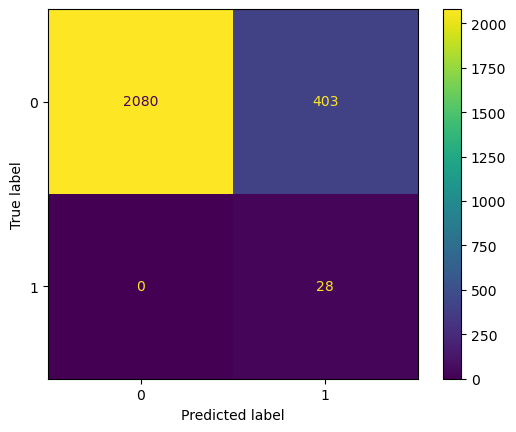

Accuracy threshold: 0.8395
F1 score threshold: 0.122
MCC score: 0.2333
              precision    recall  f1-score   support

           0       1.00      0.84      0.91      2483
           1       0.06      1.00      0.12        28

    accuracy                           0.84      2511
   macro avg       0.53      0.92      0.52      2511
weighted avg       0.99      0.84      0.90      2511

Optimal threshold: 0.5


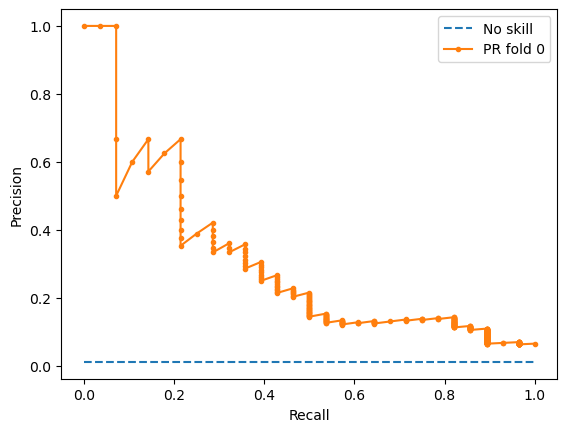

1it [00:04,  4.41s/it]

ROC/AUC: 0.974
Accuracy: 0.9769
F1 score: 0.2927
MCC score: 0.301
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      2483
           1       0.22      0.44      0.29        27

    accuracy                           0.98      2510
   macro avg       0.61      0.71      0.64      2510
weighted avg       0.99      0.98      0.98      2510



<Figure size 640x480 with 0 Axes>

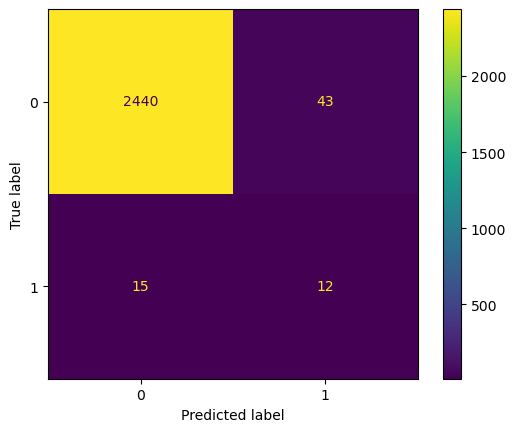

Best Threshold=0.002826, G-Mean=0.961


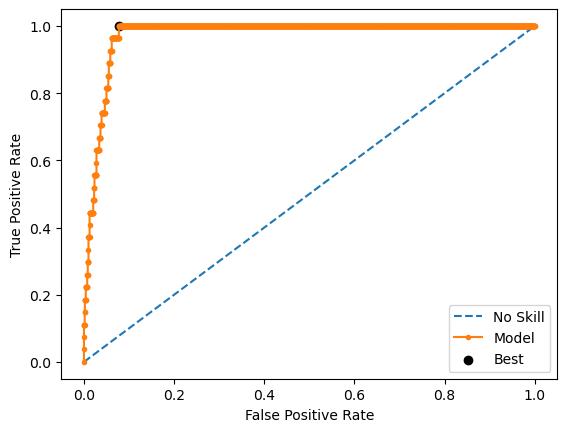

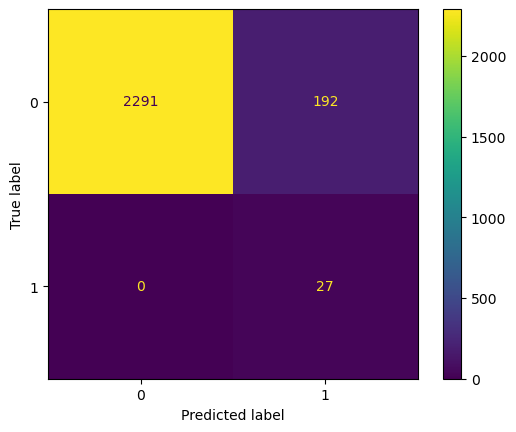

Accuracy threshold: 0.9235
F1 score threshold: 0.2195
MCC score: 0.3373
              precision    recall  f1-score   support

           0       1.00      0.92      0.96      2483
           1       0.12      1.00      0.22        27

    accuracy                           0.92      2510
   macro avg       0.56      0.96      0.59      2510
weighted avg       0.99      0.92      0.95      2510

Optimal threshold: 0.5


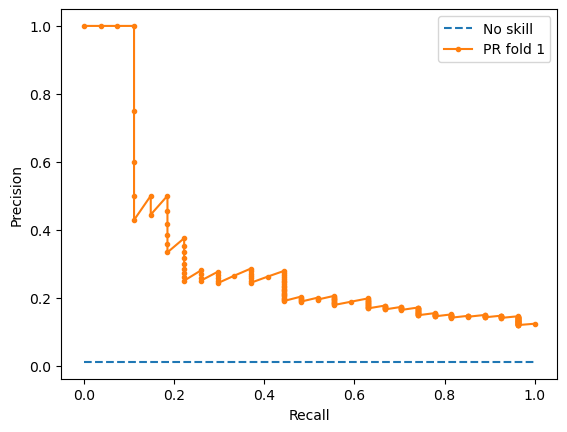

2it [00:08,  4.10s/it]

ROC/AUC: 0.9569
Accuracy: 0.9777
F1 score: 0.1765
MCC score: 0.1694
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      2483
           1       0.15      0.22      0.18        27

    accuracy                           0.98      2510
   macro avg       0.57      0.60      0.58      2510
weighted avg       0.98      0.98      0.98      2510



<Figure size 640x480 with 0 Axes>

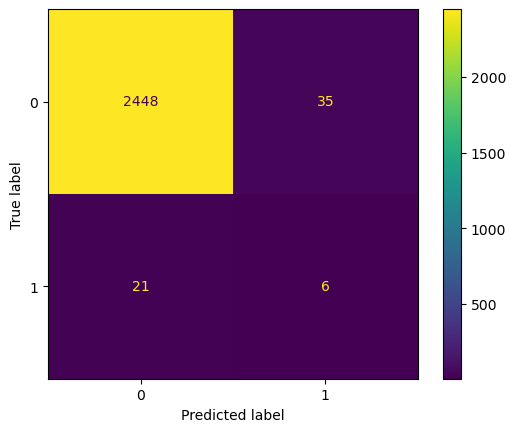

Best Threshold=0.004619, G-Mean=0.934


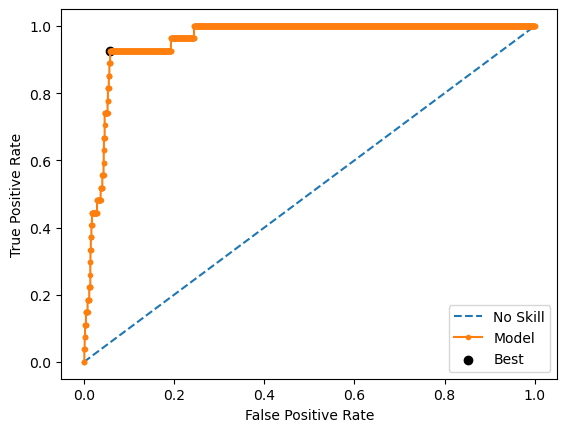

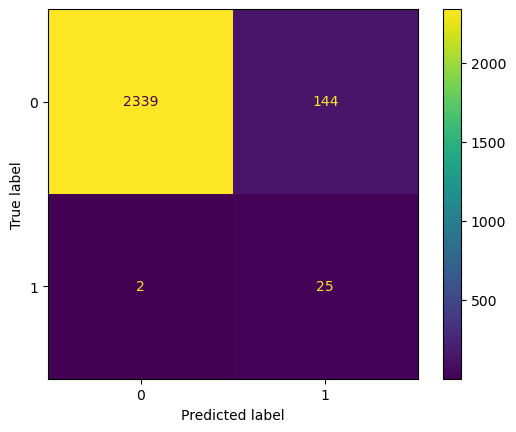

Accuracy threshold: 0.9418
F1 score threshold: 0.2551
MCC score: 0.3573
              precision    recall  f1-score   support

           0       1.00      0.94      0.97      2483
           1       0.15      0.93      0.26        27

    accuracy                           0.94      2510
   macro avg       0.57      0.93      0.61      2510
weighted avg       0.99      0.94      0.96      2510

Optimal threshold: 0.0046


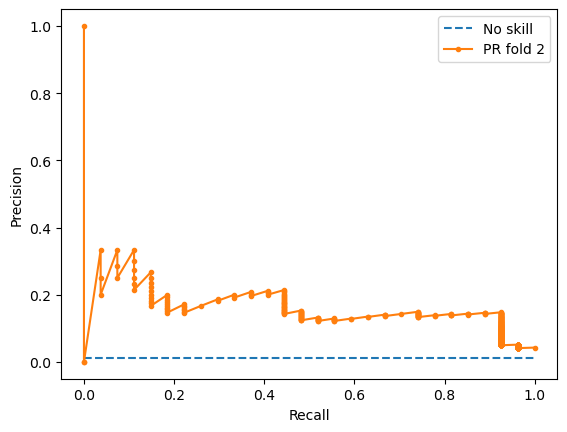

3it [00:12,  4.09s/it]


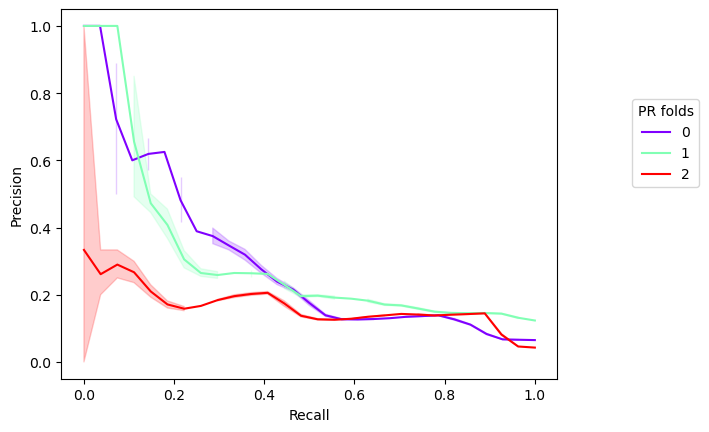

<Figure size 640x480 with 0 Axes>

In [59]:
classifier1 = DecisionTreeClassifier()

classifier2 = GaussianNB()

classifier3 = LogisticRegression()

classifier4 = RandomForestClassifier(
    n_estimators=500,
    criterion="gini",
    max_depth=10,
    max_features="auto",
    min_samples_leaf=0.005,
    min_samples_split=0.005,
    n_jobs=-1,
    random_state=1000,
)

sclf = StackingClassifier(
    classifiers=[classifier1, classifier2, classifier4], use_probas=True, meta_classifier=LogisticRegression()
)

filepath_s = os.path.join(path_folder, "models/stacking_pickle.pkl")
pickle.dump(sclf, open(filepath_s, "wb"))

ensemble_res, ensemble_threshold, ensemble_pr_data_train, ensemble_roc_data_train  = train_diag_mlflow(
        sclf, X_train_mod, y_train, n_splits, "Stacking_classifier"
)

### Final model performance

[('AdaBoost_optimized', AdaBoostClassifier(learning_rate=0.1, n_estimators=1000)), ('CatBoostClassifier_optimized', <catboost.core.CatBoostClassifier object at 0x7fe658885a80>), ('LGBM_opt_optimized', LGBMClassifier(bagging_fraction=0.1526110822260948,
               feature_fraction=0.8139011359795677,
               learning_rate=0.09849676059689247, max_bin=40, max_depth=12,
               min_data_in_leaf=60, min_sum_hessian_in_leaf=20, num_leaves=20)), ('XGB_opt_optimized', XGBClassifier(alpha=0.7438040157619862, base_score=None, booster=None,
              callbacks=None, colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.5167711259686412, gpu_id=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              lambda=0.9403599092155546, learning_rate=0.011287686578096185,
           

  0%|          | 0/6 [00:00<?, ?it/s]

AdaBoost_optimized


ROC/AUC: 0.944
Accuracy: 0.9846
F1 score: 0.0
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      1854
           1       0.00      0.00      0.00        29

    accuracy                           0.98      1883
   macro avg       0.49      0.50      0.50      1883
weighted avg       0.97      0.98      0.98      1883

[[1854    0]
 [  29    0]]


/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/keithlowton/anaconda3/envs/Binary_classifier/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

T

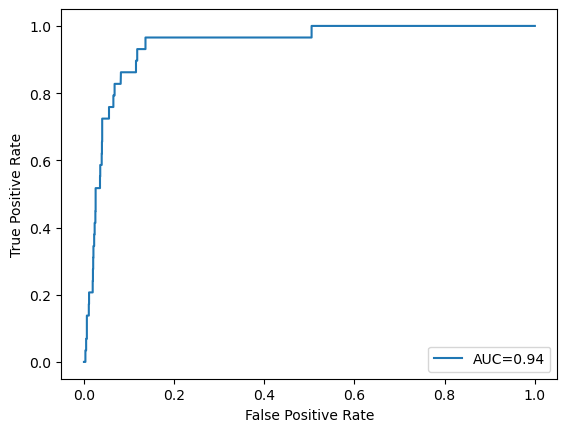

Model: f1 = 0.000 roc_auc = 0.944


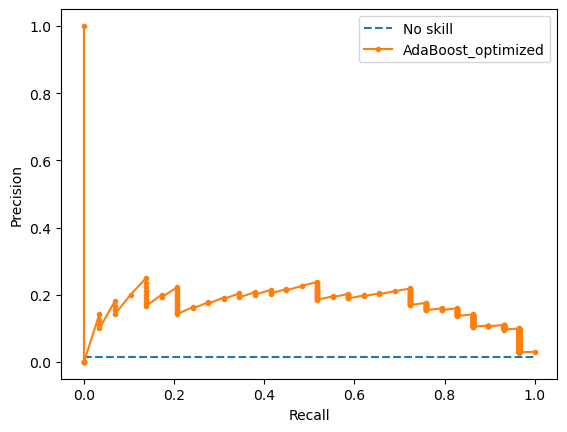

 17%|█▋        | 1/6 [00:01<00:08,  1.65s/it]

CatBoostClassifier_optimized


/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



ROC/AUC: 0.9611
Accuracy: 0.9687
F1 score: 0.3516
              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1854
           1       0.26      0.55      0.35        29

    accuracy                           0.97      1883
   macro avg       0.63      0.76      0.67      1883
weighted avg       0.98      0.97      0.97      1883

[[1808   46]
 [  13   16]]


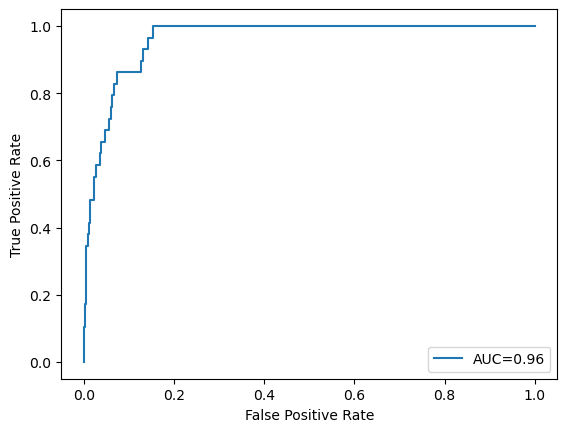

Model: f1 = 0.352 roc_auc = 0.961


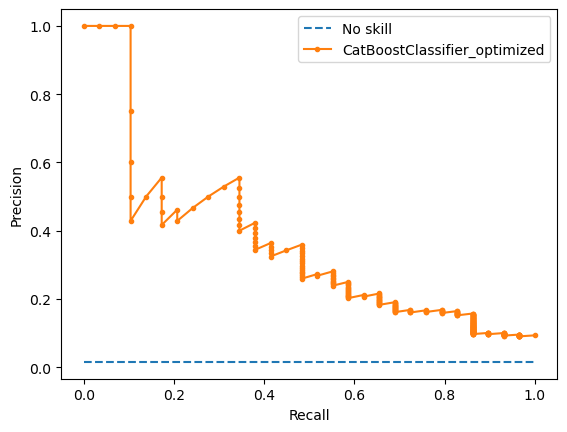

 33%|███▎      | 2/6 [00:02<00:03,  1.03it/s]

LGBM_opt_optimized


/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



ROC/AUC: 0.9614
Accuracy: 0.949
F1 score: 0.2836
              precision    recall  f1-score   support

           0       0.99      0.95      0.97      1854
           1       0.18      0.66      0.28        29

    accuracy                           0.95      1883
   macro avg       0.59      0.80      0.63      1883
weighted avg       0.98      0.95      0.96      1883

[[1768   86]
 [  10   19]]


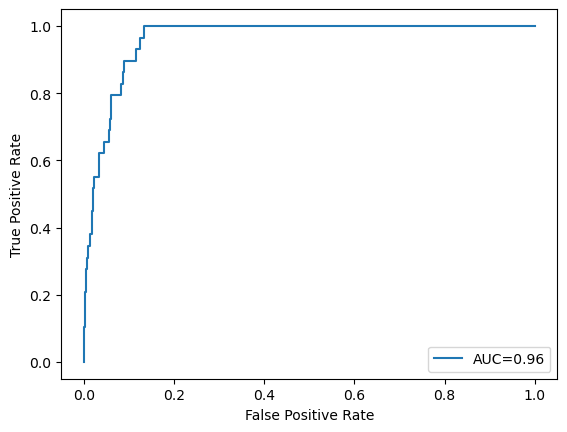

Model: f1 = 0.284 roc_auc = 0.961


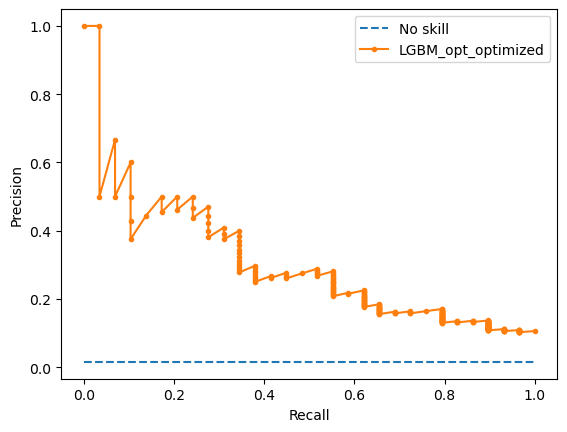

 50%|█████     | 3/6 [00:02<00:02,  1.27it/s]

XGB_opt_optimized


/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



ROC/AUC: 0.934
Accuracy: 0.9543
F1 score: 0.3065
              precision    recall  f1-score   support

           0       0.99      0.96      0.98      1854
           1       0.20      0.66      0.31        29

    accuracy                           0.95      1883
   macro avg       0.60      0.81      0.64      1883
weighted avg       0.98      0.95      0.97      1883

[[1778   76]
 [  10   19]]


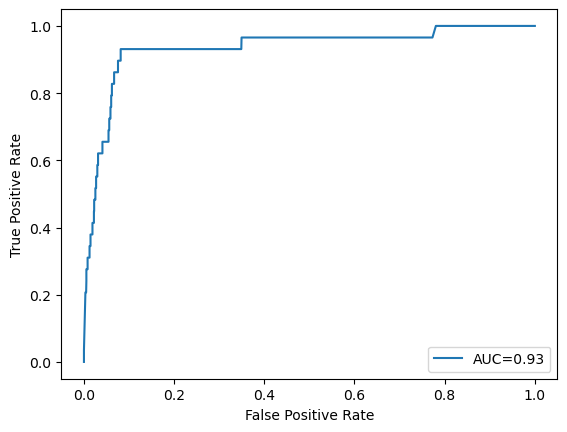

Model: f1 = 0.306 roc_auc = 0.934


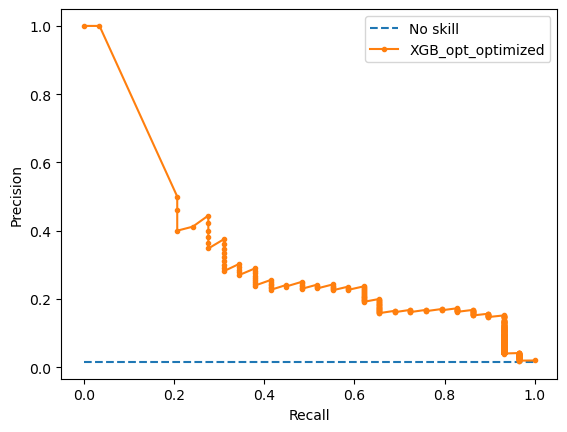

 67%|██████▋   | 4/6 [00:03<00:01,  1.42it/s]

Voting_classifier


ROC/AUC: 0.9647
Accuracy: 0.949
F1 score: 0.2727
              precision    recall  f1-score   support

           0       0.99      0.95      0.97      1854
           1       0.17      0.62      0.27        29

    accuracy                           0.95      1883
   macro avg       0.58      0.79      0.62      1883
weighted avg       0.98      0.95      0.96      1883

[[1769   85]
 [  11   18]]


/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



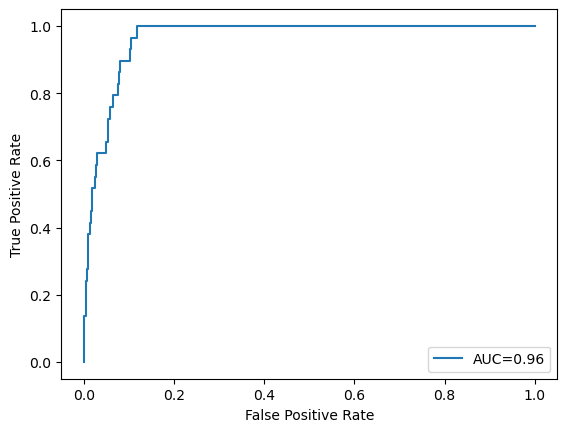

Model: f1 = 0.273 roc_auc = 0.965


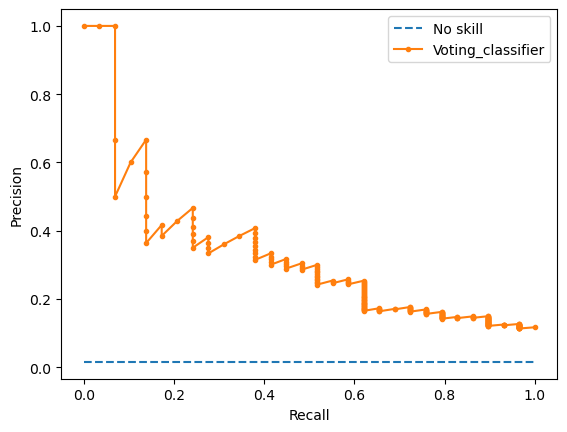

 83%|████████▎ | 5/6 [00:04<00:00,  1.01it/s]

Stacking_classifier


ROC/AUC: 0.9576
Accuracy: 0.9665
F1 score: 0.2759
              precision    recall  f1-score   support

           0       0.99      0.98      0.98      1854
           1       0.21      0.41      0.28        29

    accuracy                           0.97      1883
   macro avg       0.60      0.69      0.63      1883
weighted avg       0.98      0.97      0.97      1883

[[1808   46]
 [  17   12]]


/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/2055643832.py:18: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



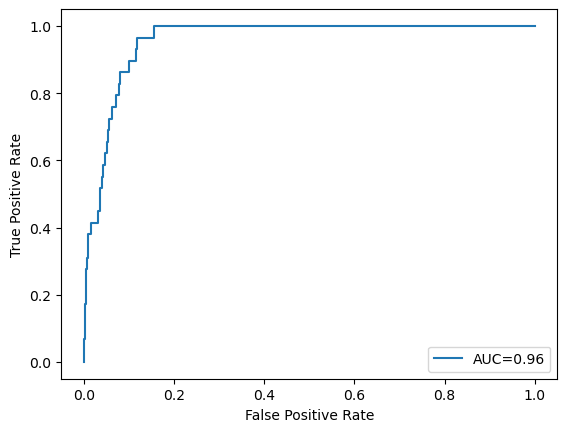

Model: f1 = 0.276 roc_auc = 0.958


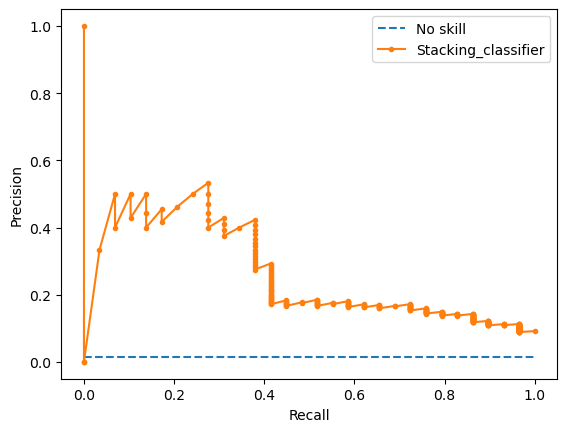

100%|██████████| 6/6 [00:05<00:00,  1.08it/s]


In [60]:
# Assess the performance of the model

models_optimized = []
pc_res = []

try:
    if not issubclass(type(ada_opt_from_pickle), abc.ABCMeta):
        models_optimized.append(("AdaBoost_optimized", ada_opt_from_pickle))
        pc_res.append(ada_res)
except Exception:
    models_optimized = models_optimized
try:
    if not issubclass(type(cb_opt_from_pickle), abc.ABCMeta):
        models_optimized.append(("CatBoostClassifier_optimized", cb_opt_from_pickle))
        pc_res.append(cb_res)
except Exception:
    models_optimized = models_optimized
try:
    if not issubclass(type(lgbm_opt_from_pickle), abc.ABCMeta):
        models_optimized.append(("LGBM_opt_optimized", lgbm_opt_from_pickle))
        pc_res.append(lgbm_opt_res)
except Exception:
    models_optimized = models_optimized
try:
    if not issubclass(type(xgb_opt_from_pickle), abc.ABCMeta):
        models_optimized.append(("XGB_opt_optimized", xgb_opt_from_pickle))
        pc_res.append(xgb_opt_res)
except Exception:
    models_optimized = models_optimized
try:
    if not issubclass(type(voting), abc.ABCMeta):
        models_optimized.append(("Voting_classifier", voting))
        pc_res.append(voting_res)
except Exception:
    models_optimized = models_optimized
try:
    if not issubclass(type(sclf), abc.ABCMeta):
        models_optimized.append(("Stacking_classifier", sclf))
        pc_res.append(ensemble_res)
except Exception:
    models_optimized = models_optimized


print(models_optimized)

dset = [("Test", X_test_mod, y_test)]

results_fin = pd.DataFrame(columns=["Model", "Metrics", "Test"])

for name, model in tqdm(models_optimized):

    print(name)

    results = pd.DataFrame(["ROC/AUC:", "Accuracy:", "F1 score:"], columns=["Metrics"])

    for name_dset, X_dset, y_dset in tqdm(dset):

        # Fit the model

        y_pred_p = model.predict_proba(X_dset)
        y_pred_p1 = y_pred_p[:, 1]

        y_pred_hyp = model.predict(X_dset)

        metric_lst = []
        roc_auc_hyp = round(roc_auc_score(y_dset, y_pred_p1), 4)
        metric_lst.append(roc_auc_hyp)
        accuracy_hyp = round(accuracy_score(y_dset, y_pred_hyp), 4)
        metric_lst.append(accuracy_hyp)
        f1_score_hyp = round(f1_score(y_dset, y_pred_hyp), 4)
        metric_lst.append(f1_score_hyp)

        print("ROC/AUC:", roc_auc_hyp)
        print("Accuracy:", accuracy_hyp)
        print("F1 score:", f1_score_hyp)

        print(classification_report(y_dset, y_pred_hyp))

        cm = confusion_matrix(y_dset, y_pred_hyp)

        cm_as_df = cm2df(cm, ["Not purchase", "Purchase"])

        print(confusion_matrix(y_dset, y_pred_hyp))

        results = pd.concat([results, pd.DataFrame(metric_lst, columns=[name_dset])], axis=1)

        # ROC curve

        fpr, tpr, _ = roc_curve(y_dset, y_pred_p1)

        plt.plot(fpr, tpr, label="AUC=" + str(round(roc_auc_hyp, 2)))
        plt.ylabel("True Positive Rate")
        plt.xlabel("False Positive Rate")
        plt.legend(loc=4)
        plt.show()

        roc_data = pd.concat([pd.DataFrame(fpr), pd.DataFrame(tpr)], axis=1)
        roc_data.columns = ["FPR", "TPR"]
        roc_data = roc_data.reset_index()

        # Precision Recall curves

        precision, recall, thresholds = precision_recall_curve(y_dset, y_pred_p1)

        # calculate F1 score

        f1_val = f1_score(y_dset, y_pred_hyp)

        # summarize scores

        print("Model: f1 = %.3f roc_auc = %.3f" % (f1_val, roc_auc_hyp))

        # plot the precision-recall curves

        no_skill = len(y_dset[y_dset == 1]) / len(y_dset)

        plt.plot([0, 1], [no_skill, no_skill], linestyle="--", label="No skill")
        plt.plot(recall, precision, marker=".", label=name)
        plt.xlabel("Recall")
        plt.ylabel("Precision")

        # show the legend
        plt.legend()
        plt.show()

        pr_data = pd.concat([pd.DataFrame(precision), pd.DataFrame(recall)], axis=1)
        pr_data.columns = ["Precision", "Recall"]
        pr_data = pr_data.reset_index()

        results["Model"] = name

    results_fin = pd.concat([results_fin, results], axis=0)


### Performance comparison

In [61]:
train_res = pd.DataFrame()

# dic.items()
# for name in [ensemble_res, voting_res]:
for name in [xgb_opt_res, lgbm_opt_res, ada_res, voting_res, ensemble_res, cb_res]:
    # for name in [xgb_hyp_res, lgbm_hyp_res, ada_res, sgd_res, cb_res]:
    try:
        train_res = pd.concat([train_res, name], axis=0)
    except Exception:
        train_res = train_res
train_res["Train_mean"] = train_res.mean(axis=1)
train_res = train_res.sort_values(["Metrics", "Train_mean", "Model"], ascending=False)


/var/folders/4t/t1tjs2gd7kzg3jkt5d1snhlh0000gn/T/ipykernel_19595/1439852502.py:11: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



In [62]:
results_final = pd.merge(results_fin, train_res, on=["Model", "Metrics"], how="left")
results_final = results_final.sort_values(["Metrics", "Test", "Model"], ascending=False)
results_final

,Model,Metrics,Test,Train_0,Train_1,Train_2,Train_mean
12,Voting_classifier,ROC/AUC:,0.9647,0.9566,0.9696,0.9493,0.958500
6,LGBM_opt_optimized,ROC/AUC:,0.9614,0.9456,0.9650,0.9491,0.953233
3,CatBoostClassifier_optimized,ROC/AUC:,0.9611,0.9256,0.9457,0.9283,0.933200
15,Stacking_classifier,ROC/AUC:,0.9576,0.9596,0.9740,0.9569,0.963500
0,AdaBoost_optimized,ROC/AUC:,0.9440,0.9456,0.9650,0.9491,0.953233
9,XGB_opt_optimized,ROC/AUC:,0.9340,0.8946,0.9648,0.9201,0.926500
5,CatBoostClassifier_optimized,F1 score:,0.3516,0.2785,0.2727,0.2857,0.278967
11,XGB_opt_optimized,F1 score:,0.3065,0.2530,0.2222,0.2238,0.233000
8,LGBM_opt_optimized,F1 score:,0.2836,0.2632,0.2695,0.2569,0.263200
17,Stacking_classifier,F1 score:,0.2759,0.2828,0.2927,0.2551,0.276867


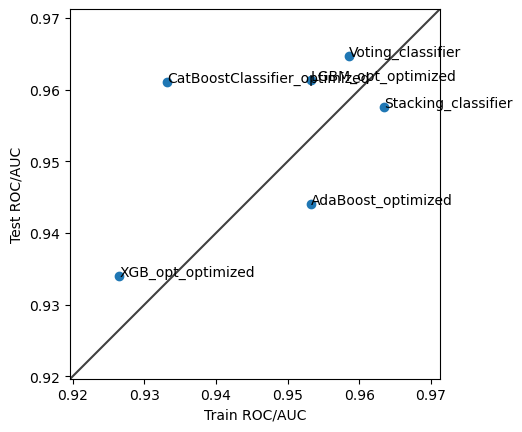

In [63]:
fig, ax = plt.subplots()
ax.scatter(data=results_final[results_final.Metrics == "ROC/AUC:"], x="Train_mean", y="Test")
text = list(results_final.loc[results_final.Metrics == "ROC/AUC:", "Model"])
x = list(results_final.loc[results_final.Metrics == "ROC/AUC:", "Train_mean"])
y = list(results_final.loc[results_final.Metrics == "ROC/AUC:", "Test"])
for i in range(len(x)):
    plt.annotate(text[i], (x[i], y[i]))
plt.xlabel("Train ROC/AUC")
plt.ylabel("Test ROC/AUC")

lims = [
    np.min([ax.get_xlim(), ax.get_ylim()]) - 0.005,  # min of both axes
    np.max([ax.get_xlim(), ax.get_ylim()]) + 0.005,  # max of both axes
]

# now plot both limits against eachother
ax.plot(lims, lims, "k-", alpha=0.75, zorder=0)
ax.set_aspect("equal")
ax.set_xlim(lims)
ax.set_ylim(lims)
plt.show()